# **Defining the Fourier Transform with Complex Numbers**



### **The Intuition Behind Complex Numbers & Fourier Transform**
The use of **magnitude and phase** can be expressed using polar coordinates with complex numbers. This allows encoding of both coefficients (magnitude and phase) into a single complex number.


---

### **Complex Fourier Transform Coefficients**

Complex Fourier Transform coefficients represent a combination of real and imaginary parts. They are visualized in the complex plane:

- **Real axis**: Represents the real part of the signal.
- **Imaginary axis**: Represents the imaginary part of the signal.

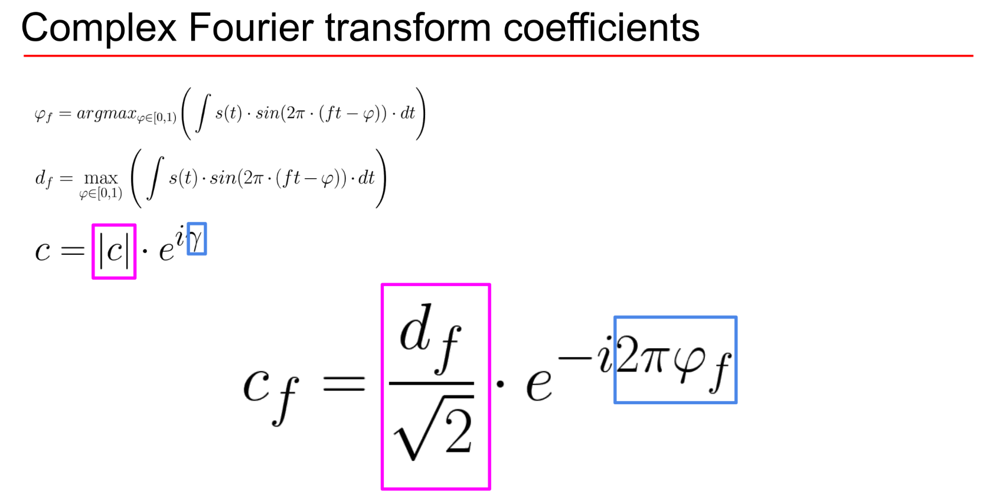

![](https://math24.net/images/header-calculus-fourier-series.svg)

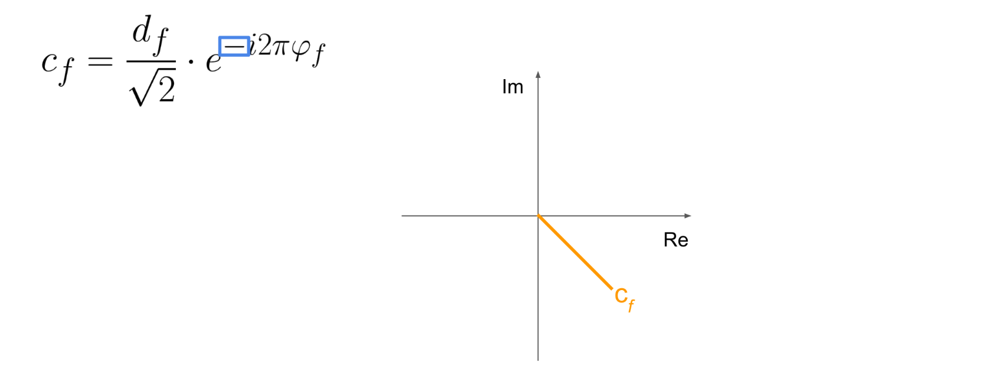

---

### **Complex Fourier Transform**
The Fourier Transform uses complex numbers to decompose audio signals into their constituent frequencies.

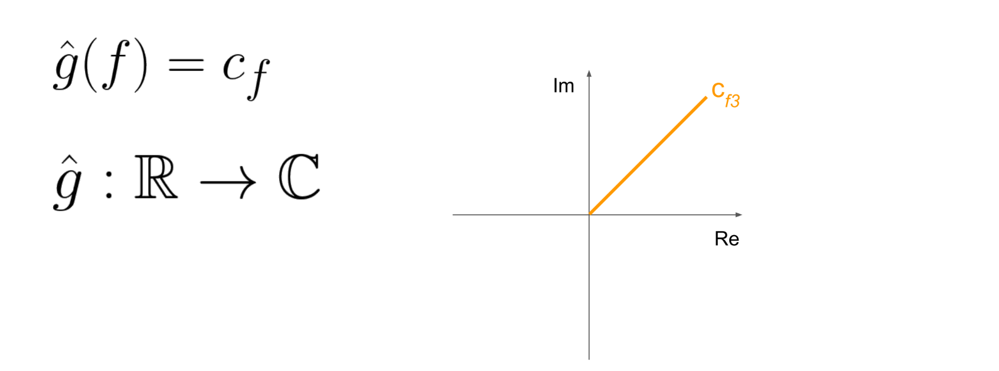

![](https://i.sstatic.net/eCpbp.gif)
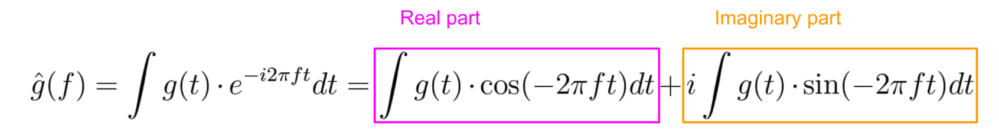

#### Steps:
1. **Continuous Audio Signal**: Analyze the audio signal in time.
2. **Transform to Frequency Domain**: Represent audio signals using **complex sinusoids**.
   - These sinusoids are represented by their magnitude and phase properties.
3. **Magnitude and Phase**:
   - Magnitude gives the strength of the frequency.
   - Phase provides temporal alignment information.

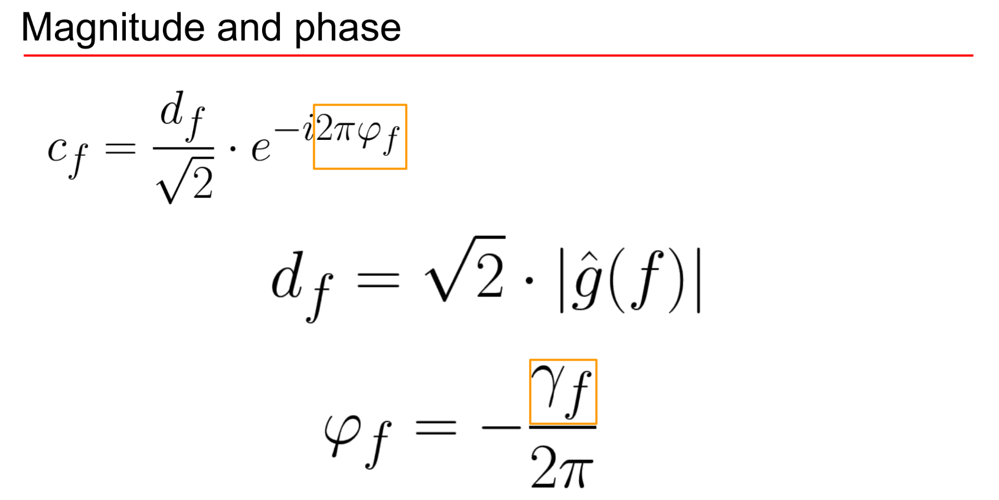

---

### **Inverse Fourier Transform**
The process of reconstructing the original signal from its frequency components is achieved by the **Inverse Fourier Transform (IFT)**. 

[numerical-tours](https://www.numerical-tours.com/matlab/audio_1_processing/)

![](https://www.testandmeasurementtips.com/wp-content/uploads/2024/12/Nelson_IFFT_pt1_fig1-1024x265.jpg)

#### How it Works:
- Combine all sinusoids (weighted by their magnitudes and phases) together to recreate the original audio signal.

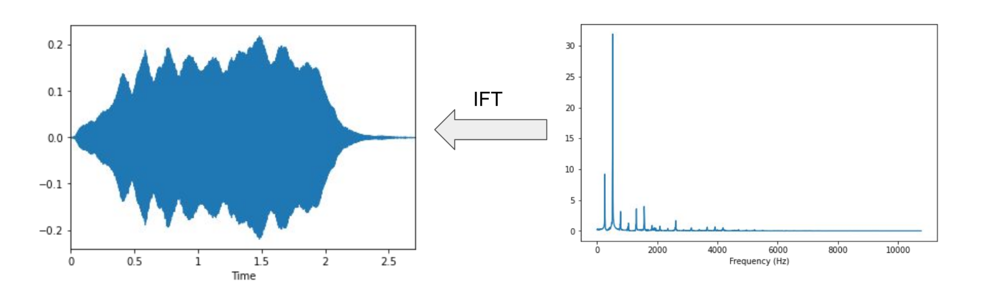
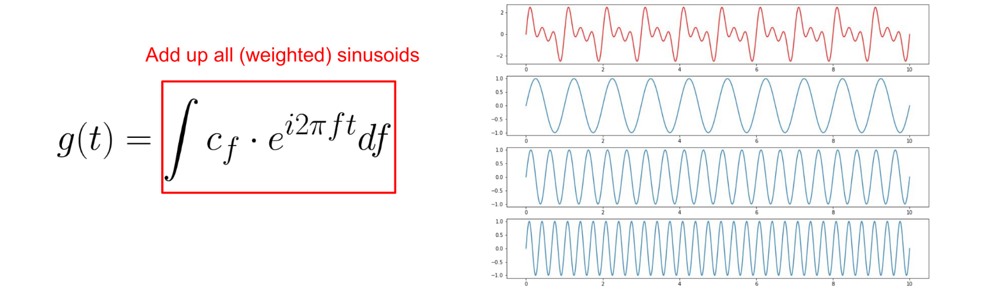
---

### **Fourier Representation**
The Fourier Transform represents the audio signal using sinusoids (pure tones) with different frequencies, magnitudes, and phases.

#### Example: Pure Tone Representation
1. Select a pure tone with frequency `f`.
2. Weight it with the appropriate magnitude and phase.
3. Combine it with other frequencies through summation.

---

### **Fourier Roundtrip**
The entire process of decomposing signals into frequency components and reconstructing them can be visualized as:

1. **Transform**: Decompose a signal into sinusoids using the **Fourier Transform**.
2. **Reconstruct**: Combine these sinusoids back using the **Inverse Fourier Transform** to obtain the original signal.

---

Complex numbers simplify this entire process by using magnitude and phase information in a single computation, making spectral analysis computationally efficient and intuitive in audio signal processing.

In [43]:
import cmath
import matplotlib.pyplot as plt
import numpy as np

In [44]:
def create_signal(frequency, time):
    sin1 = np.sin(2 * np.pi * (frequency * time))    
    sin2 = np.sin(2 * np.pi * (2* frequency * time))
    sin3 = np.sin(2 * np.pi * (3 * frequency * time))

    return sin1 + sin2 + sin3


In [45]:
def calculate_center_of_gravity(mult_signal):
    x_center = np.mean([x.real for x in mult_signal])
    y_center = np.mean([x.imag for x in mult_signal])  # Fixed from x.img to x.imag
    return x_center, y_center

In [46]:
def calculate_sum(mult_signal):
    x_sum = np.sum([x.real for x in mult_signal])
    y_sum = np.sum([x.imag for x in mult_signal])  # Fixed from x.img to x.imag
    return x_sum, y_sum

In [47]:
def create_pure_tone(frequency, time):
    angle = -2 * np.pi * frequency * time
    return np.cos((angle) + 1) * np.sin(angle) 

In [48]:
def plot_signal(signal, time):
    plt.figure(figsize=(15, 10))
    plt.plot(signal, time)
    plt.xlabel("Time")
    plt.ylabel("Intensity")
    plt.show()

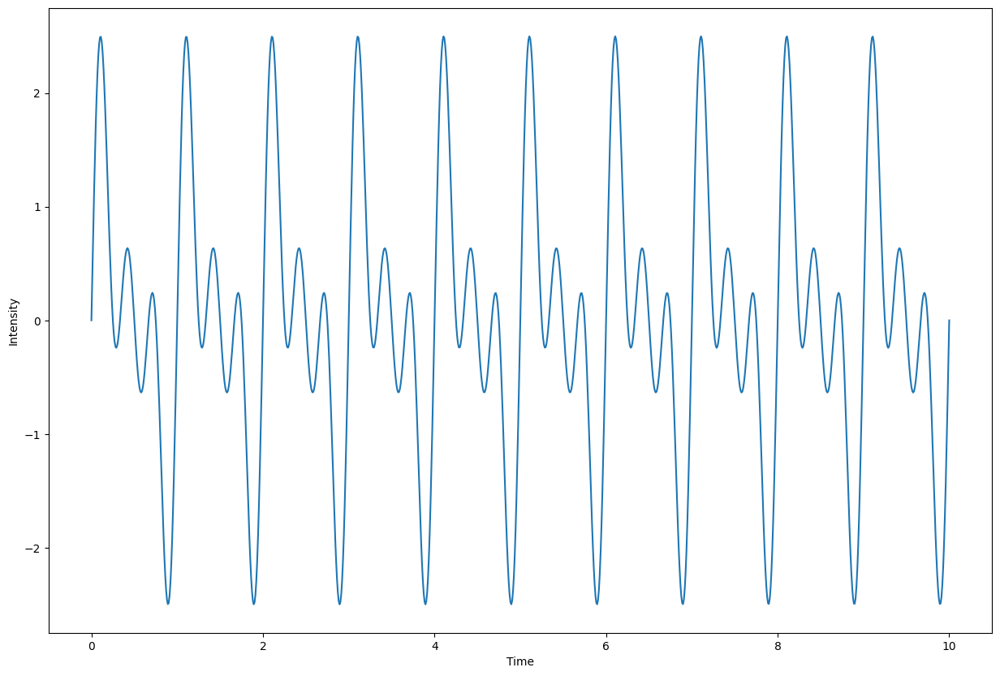

In [49]:
time = np.linspace(0, 10, 1000)
signal = create_signal(frequency=1, time=time)
plot_signal(time, signal)

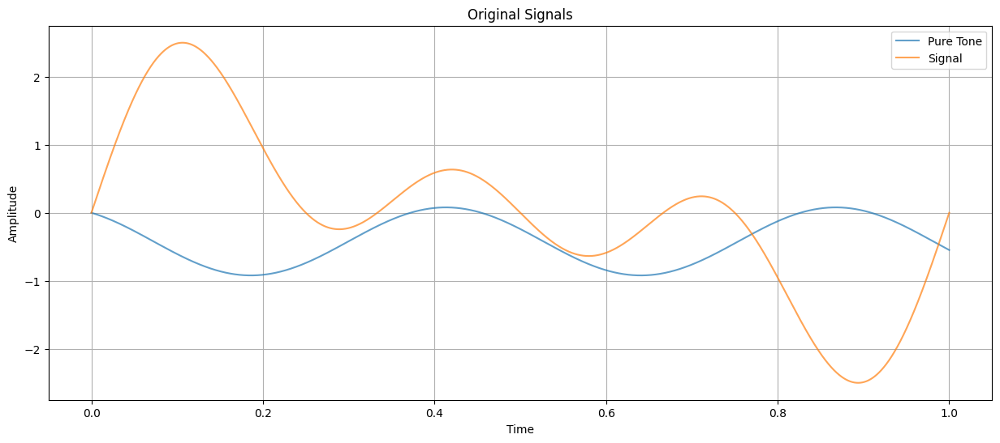

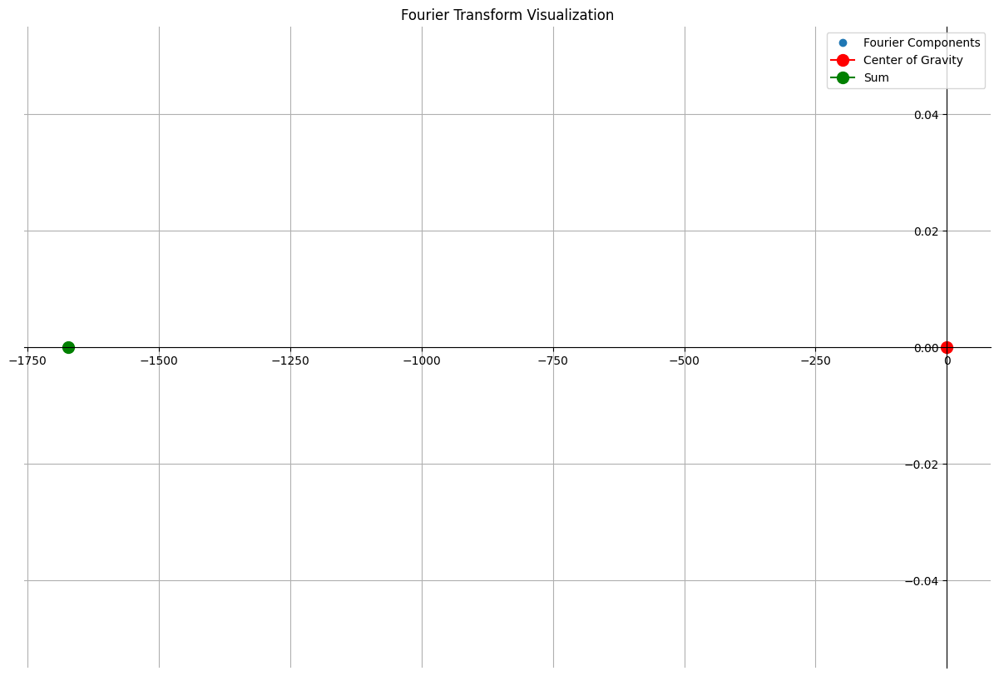

In [50]:
def plot_fourier_transform(pure_tone_frequency, 
                           signal_frequency, 
                           time, 
                           plot_centre_of_gravity=False,
                           plot_sum=False):
    
    # Create sinusoid and signal
    pure_tone = create_pure_tone(pure_tone_frequency, time)
    signal = create_signal(signal_frequency, time)
    
    # Plot the signals
    plt.figure(figsize=(15, 6))
    plt.plot(time, pure_tone, label='Pure Tone', alpha=0.7)
    plt.plot(time, signal, label='Signal', alpha=0.7)
    plt.title("Original Signals")
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.grid()
    plt.show()
    
    # Multiply pure tone and signal
    mult_signal = pure_tone * signal
    
    X = [x.real for x in mult_signal]
    Y = [x.imag for x in mult_signal]

    plt.figure(figsize=(15, 10))
    plt.plot(X, Y, 'o', label="Fourier Components")

    # Calculate and plot centre of gravity
    if plot_centre_of_gravity:
        centre_of_gravity = calculate_center_of_gravity(mult_signal)
        plt.plot([centre_of_gravity[0]], [centre_of_gravity[1]], marker='o', markersize=10, color="red", label="Center of Gravity")

    # Calculate and plot sum 
    if plot_sum:
        integral = calculate_sum(mult_signal)
        plt.plot([integral[0]], [integral[1]], marker='o', markersize=10, color="green", label="Sum")

    # Set origin axes
    ax = plt.gca()
    ax.grid(True)
    ax.spines['left'].set_position('zero')
    ax.spines['right'].set_color('none')
    ax.spines['bottom'].set_position('zero')
    ax.spines['top'].set_color('none')

    if not plot_sum:
        plt.xlim(-3, 3)
        plt.ylim(-3, 3)

    plt.legend()
    plt.title("Fourier Transform Visualization")
    plt.show()


# Time array
time = np.linspace(0, 1, 10000)

# Plot the Fourier transform and signal
plot_fourier_transform(pure_tone_frequency=1.1,
                       signal_frequency=1,
                       time=time,
                       plot_centre_of_gravity=True,
                       plot_sum=True)

# **Discrete Fourier Transform Explained Easily**

### **Previously...**  
To analyze signals digitally, we transition from **continuous signals** to **digital signals** through a process called **digitalization** or **sampling**. Digitalization involves taking discrete samples of a continuous signal at specific intervals, making it possible to analyze and process the signal using digital systems.


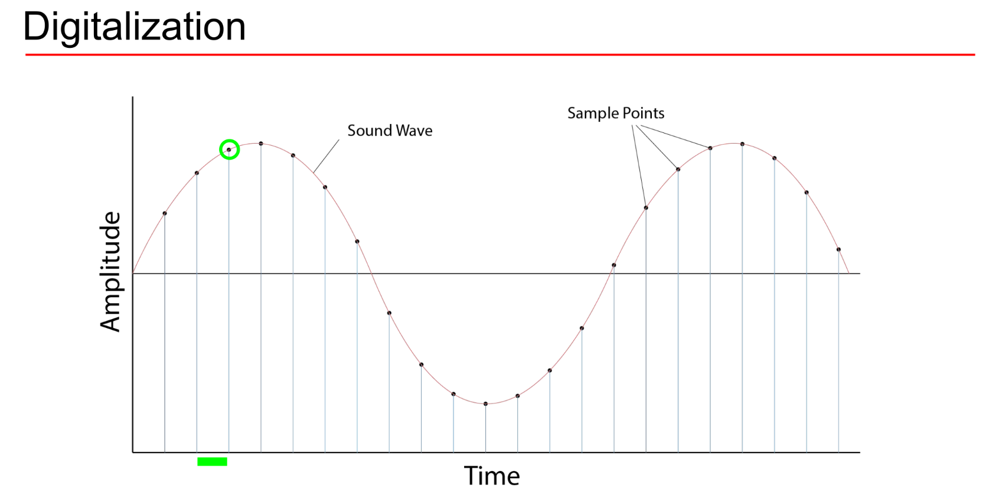
---

### **Building the Discrete Fourier Transform (DFT)**  

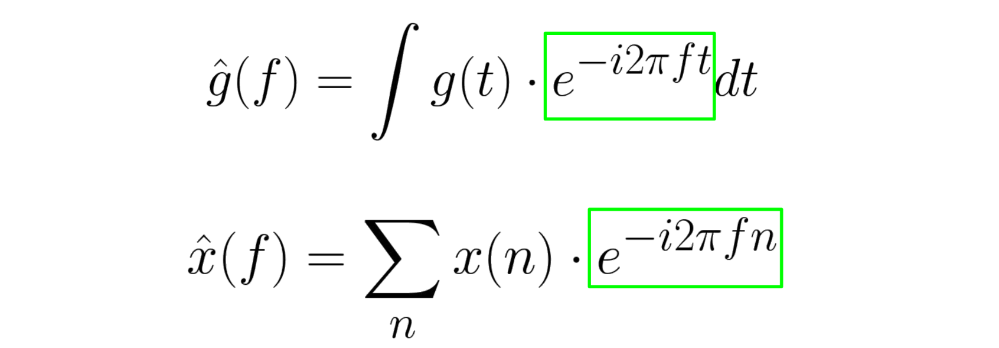

The **Discrete Fourier Transform (DFT)** provides a method to analyze the frequency content of a digital signal by breaking it into sinusoidal components. Here's how we simplify the problem:

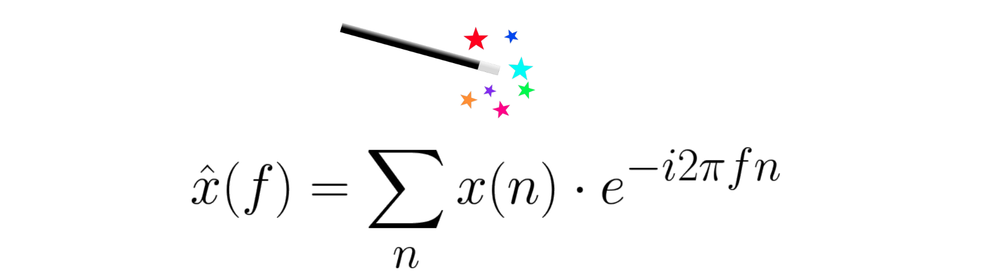

---

#### **Hacks to Simplify the Problem**  

1. **Time Domain Hack**:  
   - We assume that the original signal ``f(t)`` is **non-zero** only over a finite time interval. This simplifies the continuous signal into a finite set of samples.  
   - The signal is represented as a sequence of ``N`` samples:  
     ``x(0), x(1), x(2), ..., x(N-1)``  
     Here, ``N`` is the total number of samples, and each sample ``x(n)`` corresponds to the value of the signal at specific, evenly spaced time intervals.  

   - **Why limit the time interval?**  
     - Real-world signals are often finite in duration, and it is computationally practical to work with a finite set of data points.  


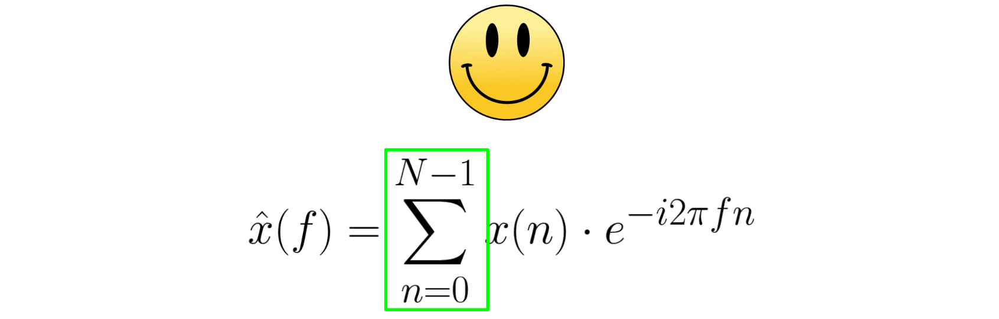

2. **Frequency Domain Hack**:  
   - Instead of computing the transform over an infinite range of frequencies (as done in the Continuous Fourier Transform), we compute it for a **finite number of frequencies**.  
   - Specifically, the number of frequency components ``M`` is chosen to match the number of samples ``N``:  
     ``M = N``  

   - **Why M = N?**  
     - Ensures the DFT is **invertible**, meaning we can reconstruct the original signal from its frequency representation.  
     - Aligning the number of frequency components with the number of samples makes the transform both practical and efficient to compute.  
     - Each frequency component corresponds to a specific frequency that fits perfectly within the finite time window of the signal.  


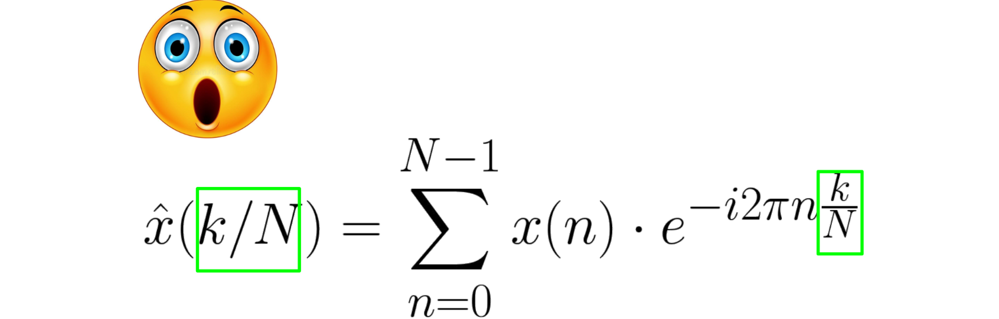
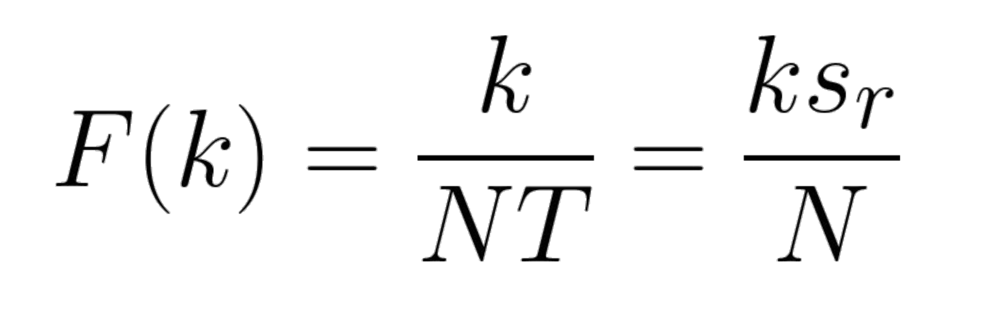


---

### **Redundancy in DFT**  

The DFT inherently exhibits **redundancy** due to the properties of sinusoids and the nature of sampling:  

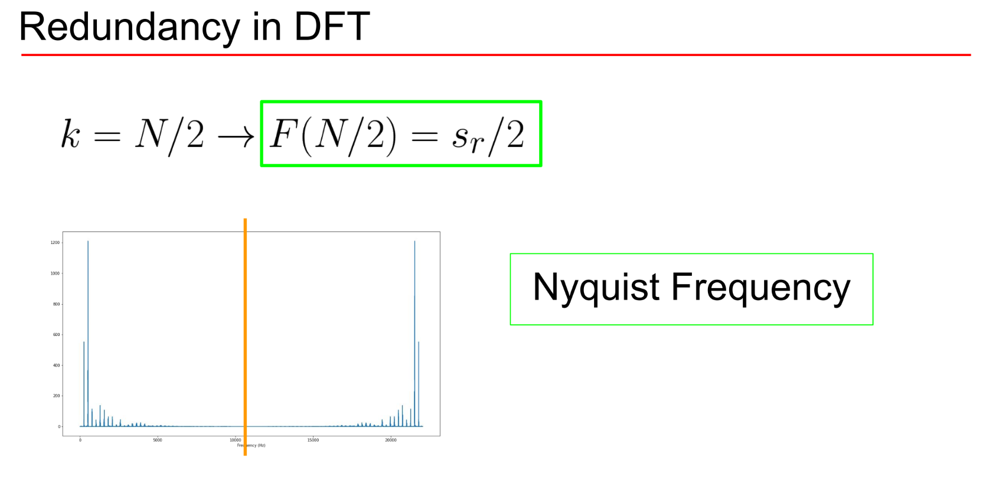

1. **Symmetry of Frequencies**:  
   - The frequencies analyzed by the DFT are symmetric because sinusoids are periodic functions.  
   - Specifically, the DFT outputs ``N`` frequency components, but only the first ``N/2`` components (for real signals) represent unique information. The remaining components mirror the first half due to symmetry.  

2. **Nyquist Frequency**:  
   - The **Nyquist Frequency** represents the **highest frequency** that can be accurately captured by a given sampling rate. It is defined as:  
     ``f_Nyquist = f_s / 2``  
     where ``f_s`` is the sampling rate (the number of samples per second).  
   - Frequencies higher than the Nyquist frequency cause **aliasing**, where high frequencies "fold" back into lower frequencies, distorting the signal.  

---

### **From DFT to Fast Fourier Transform (FFT)**  

#### **Why FFT?**  
The **DFT** is computationally expensive because it involves ``N^2`` operations to compute ``N`` frequency components for a signal of length ``N``:  
Complexity: ``O(N^2)``  
As ``N`` increases, this quickly becomes impractical for large signals.  

The **FFT (Fast Fourier Transform)** significantly improves efficiency by reducing the computational complexity to:  
Complexity: ``O(N log2 N)``  

---

#### **How FFT Works**  
The FFT achieves this improvement by **exploiting redundancies** in the DFT:  

1. **Symmetry and Periodicity**:  
   - FFT avoids unnecessary computations by leveraging the symmetric and periodic nature of sinusoids used in the DFT.  
   - For example, calculations involving mirror-image frequencies are shared, reducing the number of operations.  

2. **Divide and Conquer**:  
   - The FFT uses a "divide and conquer" approach, recursively breaking the DFT into smaller subproblems that are easier to solve.  
   - This works best when ``N`` is a **power of 2** (e.g., ``N = 2^k``), as the signal can be evenly split at each step.  

3. **Efficiency for Real-Time Applications**:  
   - Because of its speed, the FFT is widely used in real-time systems such as digital audio, communication systems, and signal processing applications.  

---

### **Summary**  

The **Discrete Fourier Transform** bridges the gap between continuous signals and their frequency representation in the digital domain. Here's how it works:  

1. **Finite Time Interval**:  
   - The signal is approximated using a **finite number of samples**.  

2. **Finite Frequency Components**:  
   - The frequency representation is limited to ``N`` components, matching the number of samples.  

3. **Redundancy and Efficiency**:  
   - The DFT exhibits **symmetry**, allowing us to discard redundant computations.  
   - The **FFT** further optimizes the DFT, reducing computational cost to ``O(N \log_2 N)``.  

Together, these ideas make frequency analysis practical for modern digital systems, enabling applications in audio processing, image analysis, communications, and more.


# **How to Extract the Fourier Transform with Python**


In [2]:
%pip install --upgrade pip setuptools wheel


Note: you may need to restart the kernel to use updated packages.


In [3]:
%pip install numpy==1.26.4


Note: you may need to restart the kernel to use updated packages.


In [4]:
!pip show numba numpy


Name: numba
Version: 0.60.0
Summary: compiling Python code using LLVM
Home-page: https://numba.pydata.org
Author: 
Author-email: 
License: BSD
Location: /home/ferganey/spechmdl/lib/python3.12/site-packages
Requires: llvmlite, numpy
Required-by: librosa, openai-whisper
---
Name: numpy
Version: 1.26.4
Summary: Fundamental package for array computing in Python
Home-page: https://numpy.org
Author: Travis E. Oliphant et al.
Author-email: 
License: Copyright (c) 2005-2023, NumPy Developers.
All rights reserved.

Redistribution and use in source and binary forms, with or without
modification, are permitted provided that the following conditions are
met:

    * Redistributions of source code must retain the above copyright
       notice, this list of conditions and the following disclaimer.

    * Redistributions in binary form must reproduce the above
       copyright notice, this list of conditions and the following
       disclaimer in the documentation and/or other materials provided
     

In [4]:
import numpy
print(numpy.__version__)
print(numpy.__file__)


1.26.4
/home/ferganey/spechmdl/lib/python3.12/site-packages/numpy/__init__.py


In [5]:
%pip install --upgrade pip setuptools wheel


Note: you may need to restart the kernel to use updated packages.


In [6]:
%pip install librosa


Note: you may need to restart the kernel to use updated packages.


In [7]:
%pip install matplotlib


Note: you may need to restart the kernel to use updated packages.


In [11]:
import librosa
import librosa.display
import scipy as sp
from IPython.display import Audio
import matplotlib.pyplot as plt
import numpy as np
import os

In [13]:
BASE_FOLDER = "/media/sda1/03_Projects/Final_Learning_AI-Projects/02_DeepLearning_Projects/00_Speech_Recognition_RasPi_ContainerzedApp/02_Ref/AudioSignalProcessingForML/14- Extracting the Discrete Fourier Transform/audio/"
violin_sound_file = "violin_c.wav"
piano_sound_file = "piano_c.wav"
sax_sound_file = "sax.wav"
noise_sound_file = "noise.wav"

In [14]:
Audio(os.path.join(BASE_FOLDER, violin_sound_file)) 

In [15]:
Audio(os.path.join(BASE_FOLDER, piano_sound_file)) 

In [16]:
Audio(os.path.join(BASE_FOLDER, sax_sound_file)) 

In [17]:
Audio(os.path.join(BASE_FOLDER, noise_sound_file)) 

In [18]:
# load sounds
violin_c4, sr = librosa.load(os.path.join(BASE_FOLDER, violin_sound_file))
piano_c5, _ = librosa.load(os.path.join(BASE_FOLDER, piano_sound_file))
sax_c4, _ = librosa.load(os.path.join(BASE_FOLDER, sax_sound_file))
noise, _ = librosa.load(os.path.join(BASE_FOLDER, noise_sound_file))

In [19]:
len(violin_c4)

59772

In [21]:
violin_c4.shape

(59772,)

In [20]:
X = np.fft.fft(violin_c4)
len(X)

59772

In [23]:
X[0]

(-0.8535723889840482-8.298917109073045e-15j)

In [24]:
magnituide_spectrum_violin = np.abs(X)

In [25]:
magnituide_spectrum_violin[0]

0.8535723889840482

In [32]:
def plot_magnitude_spectrumone(signal, sr, title, f_ratio=1):
    X = np.fft.fft(signal)
    X_mag = np.abs(X)
    
    plt.figure(figsize=(18, 5))
    
    f = np.linspace(0, sr, len(X_mag))

    plt.plot(f, X_mag)
    plt.xlabel('Frequency (Hz)')
    plt.title(title)  
    plt.show()  

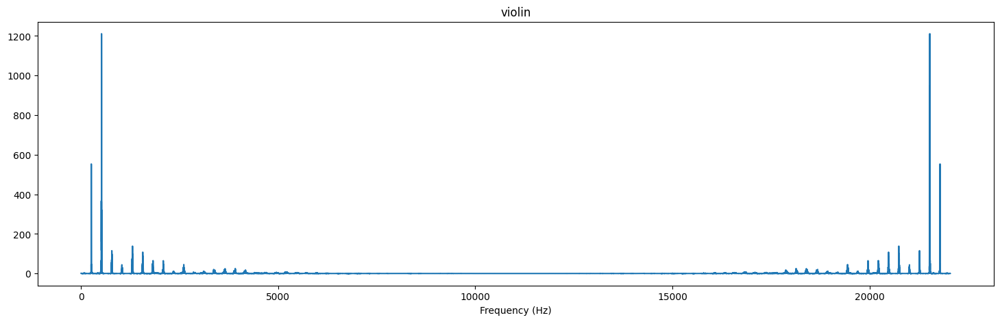

In [33]:
plot_magnitude_spectrumone(violin_c4, sr, "violin")

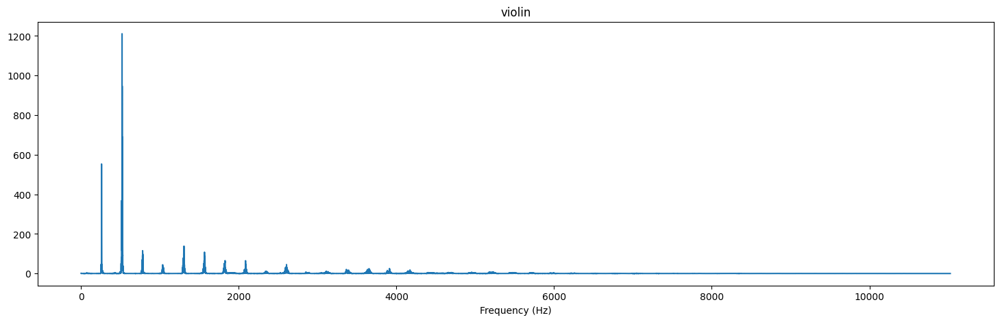

In [42]:
def plot_magnitude_spectrumonethree(signal, sr, title, f_ratio=1):
    # Compute the FFT of the signal
    X = np.fft.fft(signal)
    X_mag = np.abs(X)  # Magnitude of the FFT

    # Set up the figure
    plt.figure(figsize=(18, 5))

    # Create frequency array
    f = np.linspace(0, sr, len(X_mag))
    
    # Calculate number of bins to visualize
    num_bins = int(len(f) * f_ratio)

    # Plot magnitude spectrum
    plt.plot(f[:num_bins], X_mag[:num_bins])
    plt.xlabel('Frequency (Hz)')
    plt.title(title)
    plt.show()

plot_magnitude_spectrumonethree(violin_c4, sr, "violin", 0.5)


In [34]:
def plot_magnitude_spectrum(signal, sr, title, f_ratio=1):
    X = np.fft.fft(signal)
    X_mag = np.abs(X)
    
    plt.figure(figsize=(18, 5))
    
    f = np.linspace(0, sr, len(X_mag))
    f_bins = int(len(X_mag)*f_ratio)  
    
    plt.plot(f[:f_bins], X_mag[:f_bins])
    plt.xlabel('Frequency (Hz)')
    plt.title(title)

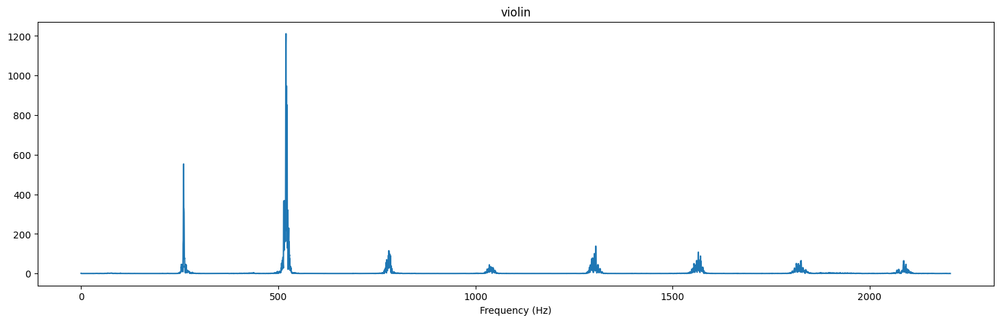

In [35]:
plot_magnitude_spectrum(violin_c4, sr, "violin", 0.1)

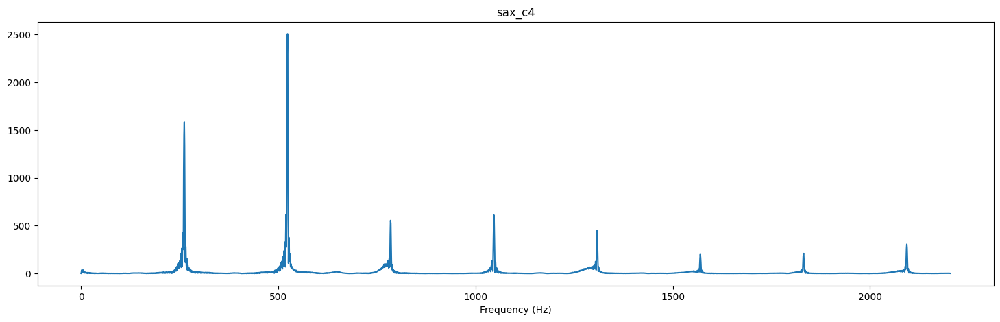

In [43]:
plot_magnitude_spectrum(sax_c4, sr, "sax_c4", 0.1)

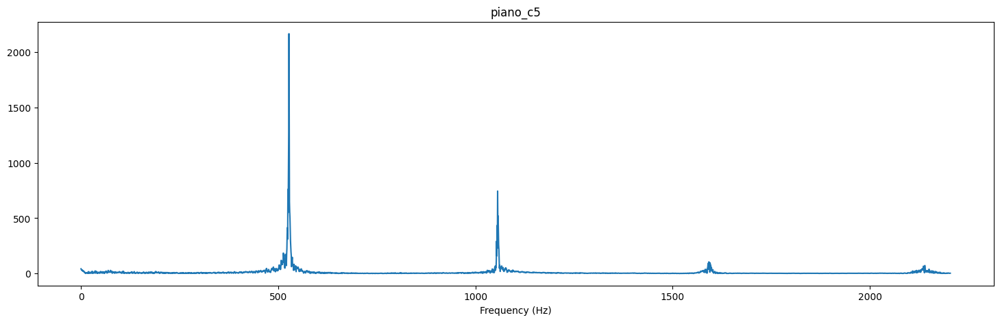

In [44]:
plot_magnitude_spectrum(piano_c5, sr, "piano_c5", 0.1)

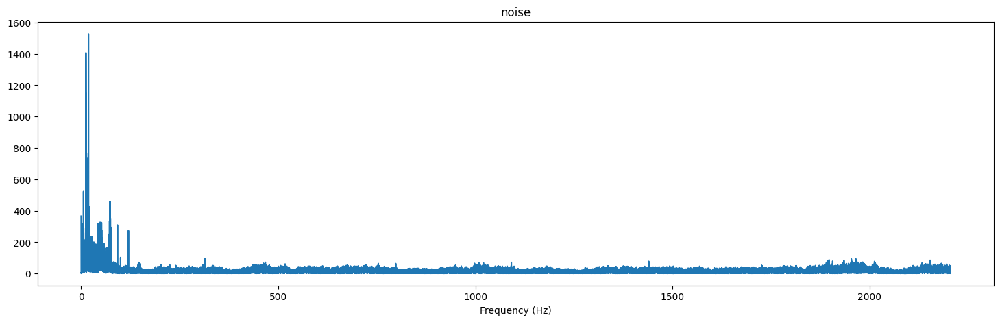

In [45]:
plot_magnitude_spectrum(noise, sr, "noise", 0.1)

# **Short-Time Fourier Transform Explained Easily**



## **Previously...**
The **Fourier Transform** and **Discrete Fourier Transform (DFT)** analyze a signal’s frequency content, but they lack **timing information**:  
- **What** frequencies exist? ✔️  
- **When** do these frequencies occur? ❌  

The Fourier Transform assumes the signal is analyzed as a whole. As a result, it cannot handle signals whose **frequency content changes over time**.  

---

## **The Problem with the Fourier Transform**

1. **Stationary vs. Non-Stationary Signals**:  
   - A **stationary signal** has constant frequency content over time (e.g., a pure sine wave).  
   - A **non-stationary signal** has frequency components that **vary** over time (e.g., speech, music, or other real-world signals).  

2. **No Timing Information**:  
   - While the Fourier Transform shows what frequencies exist in a signal, it does not tell us **when** these frequencies occur.  
   - Example: A siren starts at a low pitch and transitions to a high pitch. The Fourier Transform will show **both frequencies**, but not **when** the pitch changes.  

To address this, we need a method that provides both **frequency** and **timing** information.

---

## **Short-Time Fourier Transform (STFT): Intuition**

The **STFT** solves the "when" problem by breaking the signal into smaller segments (called **frames**) and analyzing each frame independently using the **DFT**.  

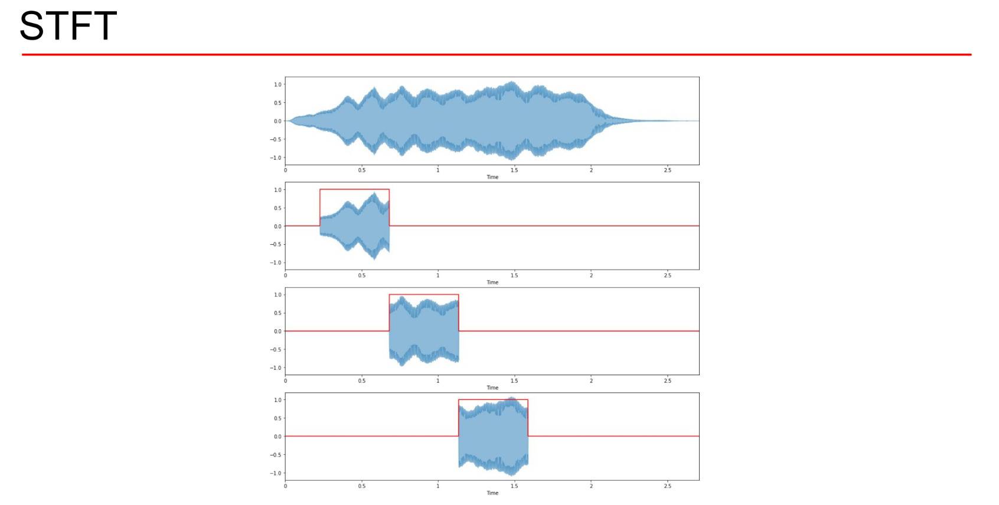

### **Frame Size vs. Window Size in Audio Signal Processing**

In audio signal processing, **frame size** and **window size** are related but distinct concepts, often used in short-time Fourier transform (STFT) and similar techniques.


### **1. Frame Size**
- **Definition**:  
  The **frame size** refers to the number of samples grouped together for analysis or processing at a single point in time.

- **Role**:  
  It determines how much of the signal (in samples) is processed in one segment (frame) at a time.

- **Key Point**:  
  A frame represents a **segment of the signal** that is analyzed individually.

- **Example**:  
   - If the sampling rate is 16,000 Hz, a frame size of 512 samples corresponds to:  
     ```
     Frame Duration = 512 / 16000 = 0.032 seconds (32 ms)
     ```
   - Frame size must balance time and frequency resolution.


### **2. Window Size**
- **Definition**:  
  The **window size** is the length of the window function (e.g., Hamming, Hann, Blackman) applied to each frame to minimize spectral leakage.

- **Role**:  
  The window function smooths the signal at the edges of the frame to reduce artifacts in the frequency domain.

- **Key Point**:  
  Window size determines **how much of the frame is “visible”** for spectral analysis.

- **Example**:  
   - If the frame size is 1024 samples, but the window size is 512, only the first 512 samples will have significant weight due to the window's tapering.


### **Differences Between Frame Size and Window Size**

| **Aspect**          | **Frame Size**                      | **Window Size**                  |
|----------------------|-------------------------------------|----------------------------------|
| **Meaning**         | Number of samples in one segment.   | Length of the window function.   |
| **Scope**           | Defines the **data segment** analyzed. | Controls edge smoothness to avoid spectral leakage. |
| **Effect**          | Defines the total number of samples to process. | Controls the weighting of the frame samples. |
| **Size**            | Can be equal to or larger than window size. | Typically smaller than or equal to the frame size. |
| **Overlap**         | Frames often overlap for smoother analysis. | Windows taper edge values for smoothing. |


### **Example to Clarify**
Suppose you have:
- A **frame size** of 1024 samples.
- A **window size** of 512 samples.

#### Steps:
1. A signal segment of 1024 samples is extracted as a **frame**.
2. A window function of 512 samples (e.g., Hamming window) is applied to **weight** the first 512 samples, tapering their values near the edges.
3. The remaining 512 samples have little or no weight due to the window function.


### **Practical Implications**
- **Frame Size**:
   - Larger frame size → Better **frequency resolution**, poorer **time resolution**.
   - Smaller frame size → Better **time resolution**, poorer **frequency resolution**.

- **Window Size**:
   - A window reduces **spectral leakage** in the frequency domain.
   - Smaller window size can result in less effective frequency analysis.


- The **frame size** determines the segment of the signal to analyze.  
- The **window size** determines how the signal within the frame is weighted to reduce spectral artifacts.  
- In many cases, the window size is equal to or smaller than the frame size, and overlapping frames ensure smoother analysis.


### **How Does It Work?**  
The STFT assumes that for a short duration (within each frame), the signal can be approximated as **stationary**.  

---

### **Steps of STFT**  

1. **Windowing**:  
   - Apply a **windowing function** to isolate a portion of the signal.  
   - The window has a defined **size** (frame size) and smooths the edges to minimize discontinuities.  
     Common windowing functions:  
     - **Hann Window** (most common)  
     - Hamming Window  
     - Gaussian Window  

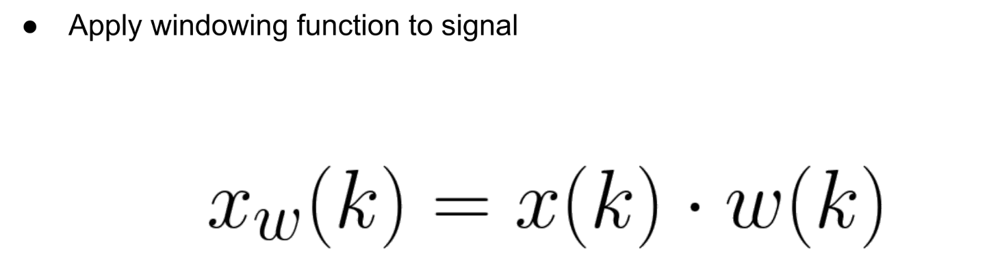

2. **Sliding Windows**:  
   - Move the window across the signal in small steps (called the **hop size**).  
   - Each step captures overlapping portions of the signal, ensuring no information is lost.  

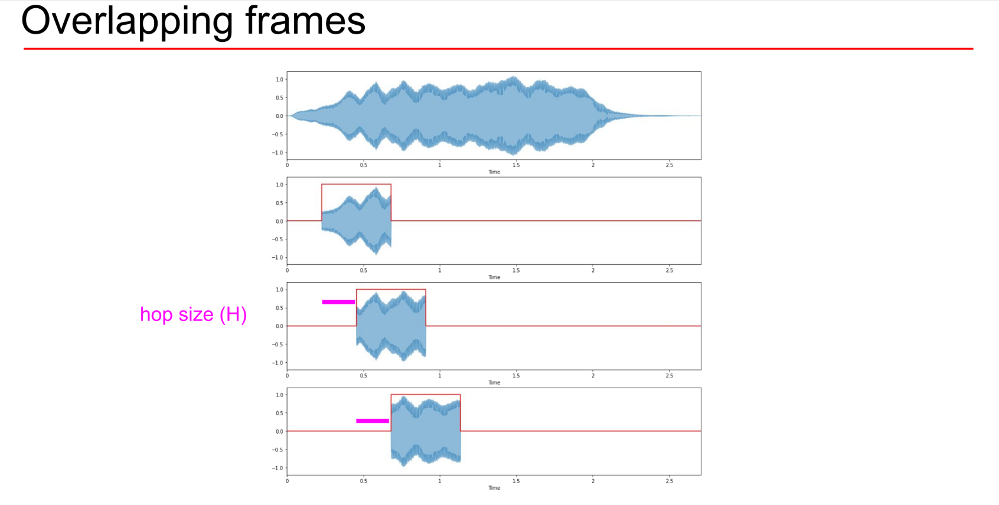

3. **DFT for Each Frame**:  
   - Perform the **DFT** on each windowed segment to analyze its frequency content.  
   - This gives the **frequency spectrum** for that specific time frame.  

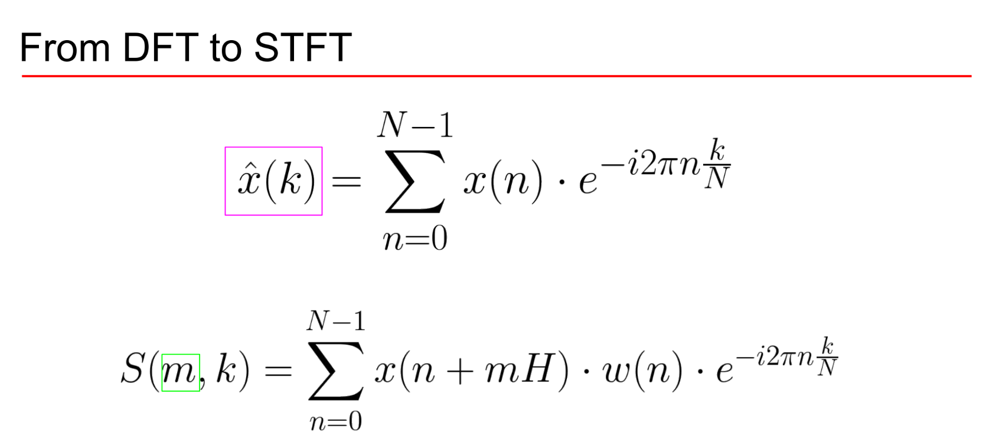
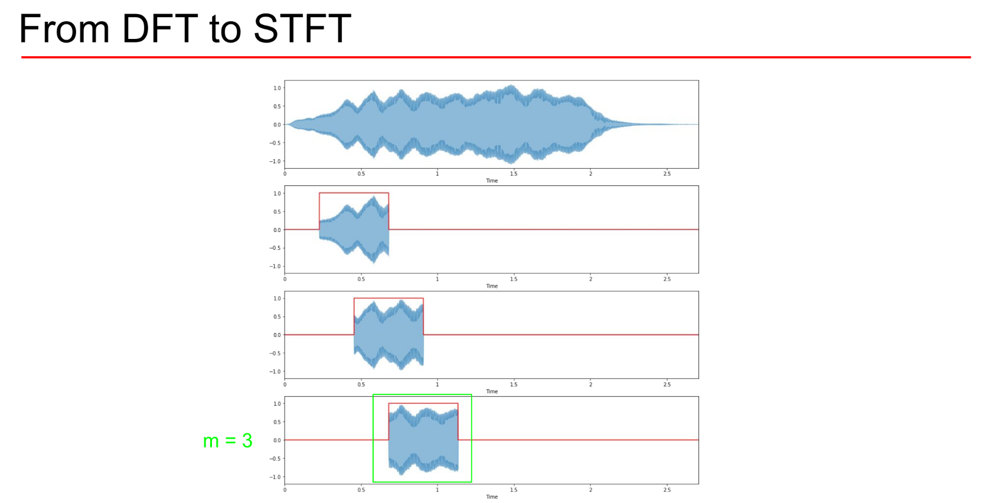

---

## **STFT Outputs**

The **STFT** outputs a **spectral matrix** that shows how the frequency content of the signal evolves over time.  

1. **DFT Output** (for one frame):  
   - A **spectral vector** containing **N/2 + 1 frequency bins** (where ``N`` is the frame size).  
   - Each bin represents a frequency range, and its magnitude/phase shows the intensity of that frequency.  

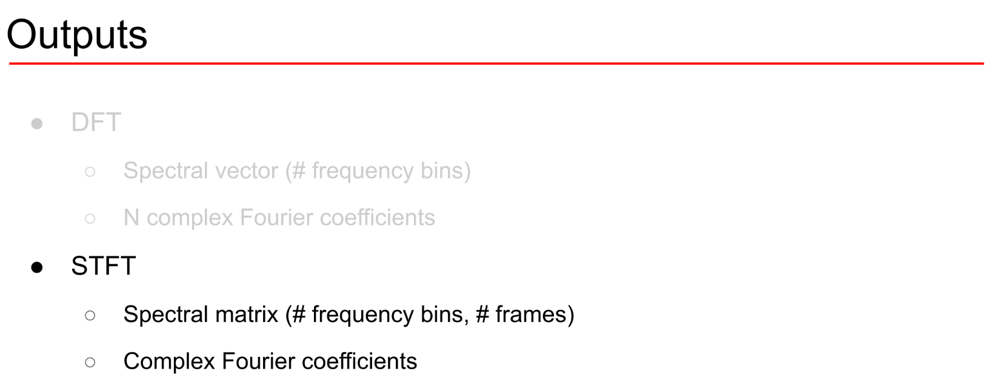

2. **STFT Output** (for the entire signal):  
   - A **spectral matrix** of dimensions:  
     **(frequency bins, number of frames)**  
   - Each column represents the spectrum for a specific time frame.  

---

## **Example of STFT Output**

### Signal Parameters:
- Total signal samples: **10,000**  
- Frame size: **1,000** samples  
- Hop size: **500** samples  

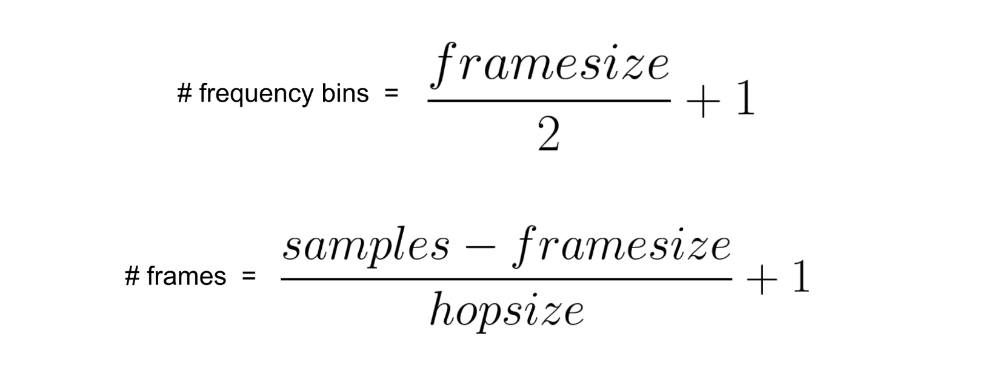

### Calculations:

1. **Frequency Bins**:  
   - Frame size divided by 2 plus 1:  
     ``N/2 + 1 = 1000 / 2 + 1 = 501``  
   - These bins represent frequencies ranging from **0 Hz** to the **Nyquist frequency** (half the sampling rate).  

2. **Number of Frames**:  
   - Total samples minus frame size, divided by hop size, plus 1:  
     ``(10,000 - 1,000) / 500 + 1 = 19``  

### Final STFT Output:
- **Spectral Matrix Dimensions**: **501 (frequency bins) × 19 (frames)**  

---

## **Key STFT Parameters**

1. **Frame Size**:  
   - Determines the length of each time segment to be analyzed.  
   - Common values: **512, 1024, 2048, 4096, 8192** samples.  
   - Larger frame size → Better frequency resolution, poorer time resolution.  

2. **Hop Size**:  
   - The step size for moving the window.  
   - Typical values:  
     - **Half K** (e.g., frame size / 2)  
     - **Quarter K** (e.g., frame size / 4)  
     - Smaller hop size → More overlap, smoother time resolution.  

3. **Windowing Function**:  
   - Smooths the edges of each frame to reduce spectral leakage.  
   - Most common: **Hann Window**.  

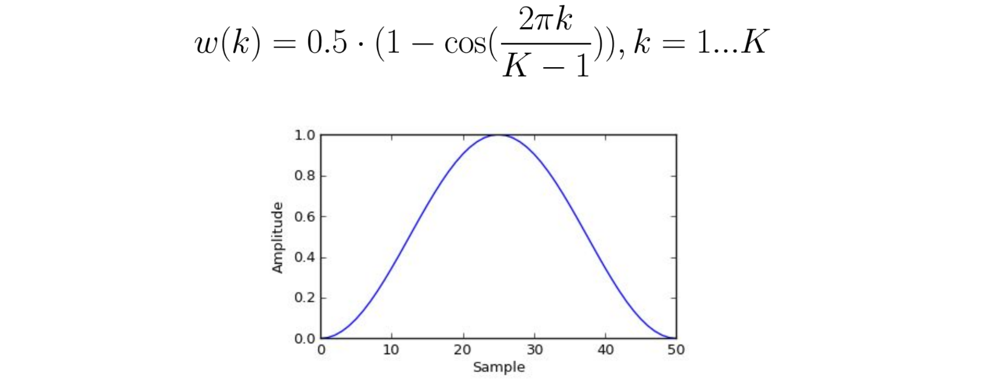
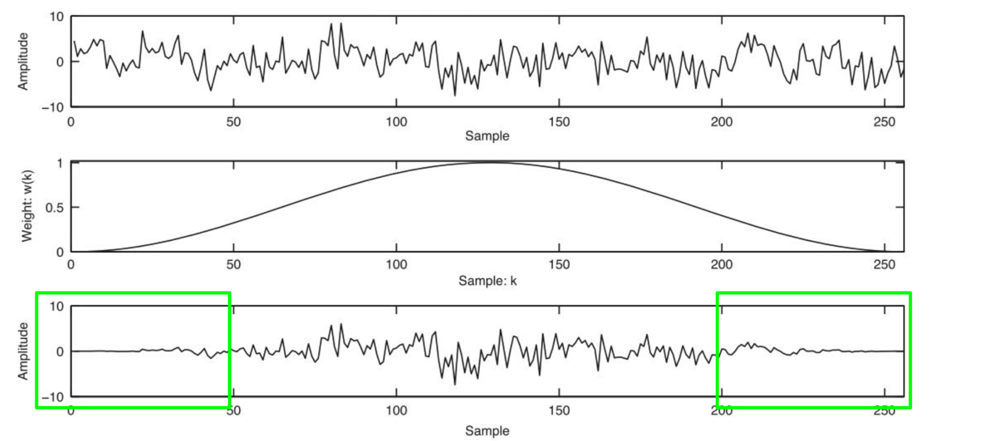

---

## **Time-Frequency Trade-Off**

The STFT involves a fundamental trade-off between **time resolution** and **frequency resolution**:  

1. **Larger Frame Size** (e.g., 4096 samples):  
   - **Better frequency resolution**: More precise identification of frequency components.  
   - **Worse time resolution**: Frequency changes over short durations are harder to detect.  

2. **Smaller Frame Size** (e.g., 512 samples):  
   - **Better time resolution**: More precise timing information.  
   - **Worse frequency resolution**: Frequency information becomes less accurate.  



### **Frequency Resolution vs. Time Resolution**

In signal processing, **frequency resolution** and **time resolution** are two competing properties, particularly in the context of analyzing signals using techniques like the Short-Time Fourier Transform (STFT).


### **1. Frequency Resolution**
- **Definition**:  
  Frequency resolution refers to the **ability to distinguish between closely spaced frequencies** in the signal.

- **Key Point**:  
  Higher frequency resolution allows you to identify **small differences** in frequency components.

- **Controlled By**:  
  The **frame size** (or analysis window duration):  
  - **Larger frame size** → Higher frequency resolution.  

- **Why?**  
  A larger frame size means analyzing a **longer duration** of the signal, providing more samples. This results in finer frequency details.

- **Trade-Off**:  
  Higher frequency resolution comes at the cost of **lower time resolution**.

- **Example**:  
  - If the frame size is 1024 samples at a sampling rate of 16,000 Hz:  
    ```
    Frequency Resolution = Sampling Rate / Frame Size
                         = 16000 / 1024 ≈ 15.6 Hz
    ```
    You can distinguish frequency components separated by at least **15.6 Hz**.


### **2. Time Resolution**
- **Definition**:  
  Time resolution refers to the **ability to locate events in time** or track changes in the signal over time.

- **Key Point**:  
  Higher time resolution allows you to detect **rapid changes** or transient events in the signal.

- **Controlled By**:  
  The **frame size** (or analysis window duration):  
  - **Smaller frame size** → Higher time resolution.

- **Why?**  
  A smaller frame size means analyzing a **shorter duration** of the signal. This allows better localization of events in time.

- **Trade-Off**:  
  Higher time resolution comes at the cost of **lower frequency resolution**.

- **Example**:  
  - If the frame size is 256 samples at a sampling rate of 16,000 Hz:  
    ```
    Frame Duration = Frame Size / Sampling Rate
                   = 256 / 16000 = 0.016 seconds (16 ms)
    ```
    You can identify events occurring within a **16 ms** window.


### **Trade-Off Between Frequency and Time Resolution**
In audio and signal processing:
- Increasing **frame size** improves frequency resolution but reduces time resolution.
- Decreasing **frame size** improves time resolution but reduces frequency resolution.

This is a consequence of the **time-frequency uncertainty principle**, which states that you **cannot achieve high resolution** in both time and frequency domains simultaneously.


### **Comparison Table**

| **Aspect**              | **Frequency Resolution**                 | **Time Resolution**                |
|-------------------------|------------------------------------------|------------------------------------|
| **Definition**          | Ability to distinguish close frequencies | Ability to locate events in time    |
| **Controlled By**       | Larger frame size (longer window)        | Smaller frame size (shorter window) |
| **Improvement**         | Longer analysis duration                | Shorter analysis duration          |
| **Trade-Off**           | Poorer time resolution                  | Poorer frequency resolution        |
| **Use Case**            | Analyzing steady-state frequencies       | Detecting short transients         |


### **Summary**
- **Frequency Resolution**: Improves with **larger frame sizes** → better for distinguishing frequencies.  
- **Time Resolution**: Improves with **smaller frame sizes** → better for identifying time-localized events.  
- There is always a **trade-off**: improving one reduces the other.





---

## **Visualizing STFT Output: Spectrogram**

The **spectrogram** is a visual representation of the STFT that shows how the frequency content of a 
signal changes over time.  

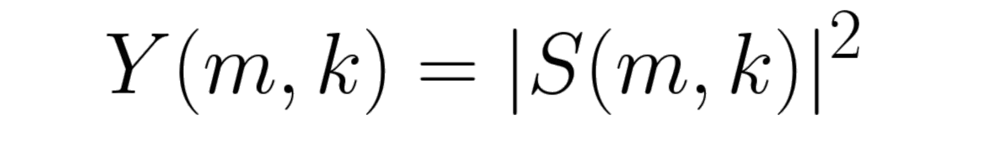

- **X-axis**: Time (frames).  
- **Y-axis**: Frequency bins (from 0 Hz to the Nyquist frequency).  
- **Color/Intensity**: Magnitude of the frequency components (e.g., brighter colors → stronger frequencies).  

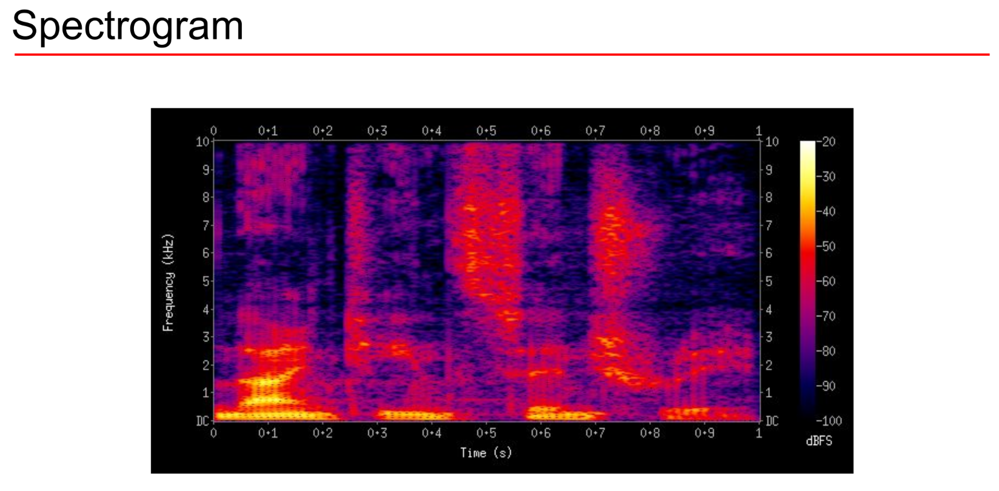

### **Spectrogram Applications**:
- **Speech Analysis**: Understanding phonemes and syllables.  
- **Music**: Visualizing harmonic content and transitions.  
- **Seismology**: Detecting frequency patterns in earthquakes.  
- **Medical Imaging**: Analyzing EEG or heart signals over time.  

---

## **Summary**

The **Short-Time Fourier Transform (STFT)** is a powerful tool for analyzing non-stationary signals by providing a **time-frequency representation**:  

1. **Windowing**: Break the signal into smaller segments using a windowing function.  
2. **Sliding Windows**: Move the window across the signal with a defined hop size.  
3. **DFT for Each Frame**: Analyze the frequency content of each segment.  
4. **Spectrogram**: Visualize the STFT output to see how frequencies evolve over time.  

The STFT effectively bridges the gap between **time-domain** and **frequency-domain** analysis, making it essential for audio processing, speech recognition, and many real-world signal applications.


## New Methods Beyond the Fourier Transform

The **Fourier Transform** and **Discrete Fourier Transform (DFT)** analyze a signal’s frequency content but lack **timing information**:

- **What frequencies exist?** ✔️  
- **When do these frequencies occur?** ❌  

The Fourier Transform assumes signals are analyzed in their entirety, which makes it inadequate for non-stationary signals whose frequency content changes over time.

---

## The Problem with the Fourier Transform

### 1. Stationary vs. Non-Stationary Signals
- **Stationary Signal**: Constant frequency content over time (e.g., a pure sine wave).  
- **Non-Stationary Signal**: Frequency components **vary** over time (e.g., speech, music, sirens).

### 2. Missing Timing Information
The Fourier Transform provides the frequencies but does **not indicate when these frequencies occur**.

---

## Alternative Methods to Address the Timing Issue

To solve the limitations of the Fourier Transform and capture both **frequency** and **time**, several advanced methods have been developed:

### 1. **Short-Time Fourier Transform (STFT)**
- Divides a signal into overlapping segments (frames) and applies **DFT** on each frame.
- Provides both **time** and **frequency** information.

#### **Trade-offs with STFT**
- Larger **frame size**: Improves frequency resolution but worsens time resolution.  
- Smaller **frame size**: Improves time resolution but worsens frequency resolution.

---

### 2. **Wavelet Transform**
The **Wavelet Transform** uses different window sizes at different scales, enabling it to analyze both low-frequency (long-term) and high-frequency (short-term) signals effectively.

#### Advantages over STFT:
- Variable time-frequency localization.
- Better suited for analyzing signals with features that change over time.

---

### 3. **Hilbert Transform**
The **Hilbert Transform** provides the **analytic signal**, which allows extraction of amplitude envelopes and instantaneous frequency from a signal.

#### Key Applications:
- Analyzing amplitude modulation and phase variations.
- Often used with other transformations for signal analysis.

---

### 4. **Wigner-Ville Distribution**
The **Wigner-Ville Distribution** is a time-frequency representation that offers improved resolution compared to STFT.

#### Limitations:
- Cross-terms can appear when signals have multiple components.
- Advanced smoothing techniques are required to handle multi-component signals.

---

### 5. **Gabor Transform**
The **Gabor Transform** is a variation of STFT with a focus on minimizing spectral leakage by fine-tuning the **window function** parameters.

---

## Time-Frequency Trade-Off
These methods rely on balancing **time resolution** and **frequency resolution**. Here's how each handles this:

| **Method**                | **Frequency Resolution**      | **Time Resolution**        | **Main Application**               |
|----------------------------|-------------------------------|----------------------------|------------------------------------|
| **STFT**                  | Fixed frame size dictates trade-offs. | Inversely related to frame size. | Speech and audio analysis.        |
| **Wavelet Transform**     | Variable scale-based analysis. | Adaptive resolution with scale. | Multi-resolution signal analysis. |
| **Hilbert Transform**     | Captures phase and amplitude information. | Focused on instantaneous frequency. | Analyzing modulation.             |
| **Wigner-Ville Distribution** | High-resolution methods. | Time-frequency analysis. | Multi-component signal analysis.  |

---

## Choosing the Right Method
Selecting an analysis method depends on the application:

- **For steady-state frequency analysis**: **STFT**.
- **For signals with varying frequency features**: **Wavelet Transform**.
- **For extracting instantaneous phase or amplitude modulations**: **Hilbert Transform**.
- **For highly precise time-frequency analysis with multiple overlapping signals**: **Wigner-Ville Distribution**.

---

## Spectrogram: A Common Visualization for STFT
The spectrogram visualizes STFT results:

- **X-axis**: Time (in frames).
- **Y-axis**: Frequency bins.
- **Color/Intensity**: Magnitude at that frequency at that point in time.

Spectrograms are commonly used in:
- **Speech Analysis**
- **Music analysis**
- **Radar and sonar signal processing**

---

## Conclusion

While the Fourier Transform is foundational, modern methods like **STFT**, **Wavelet Transform**, **Hilbert Transform**, and **Wigner-Ville Distribution** provide additional insights by incorporating timing information. 

These methods allow analysis of non-stationary signals, enabling applications across multiple fields like audio analysis, radar, speech recognition, and biomedical signal analysis.


# **How to Extract Spectrograms from Audio with Python**


In [8]:
import librosa
import librosa.display
import scipy as sp
from IPython.display import Audio
import matplotlib.pyplot as plt
import numpy as np
import os

In [9]:

scale_file ="/media/sda1/03_Projects/Final_Learning_AI-Projects/02_DeepLearning_Projects/00_Speech_Recognition_RasPi_ContainerzedApp/02_Ref/AudioSignalProcessingForML/16 - Extracting Spectrograms from Audio with Python/audio/scale.wav"
debussy_file="/media/sda1/03_Projects/Final_Learning_AI-Projects/02_DeepLearning_Projects/00_Speech_Recognition_RasPi_ContainerzedApp/02_Ref/AudioSignalProcessingForML/16 - Extracting Spectrograms from Audio with Python/audio/debussy.wav"
redhot_file ="/media/sda1/03_Projects/Final_Learning_AI-Projects/02_DeepLearning_Projects/00_Speech_Recognition_RasPi_ContainerzedApp/02_Ref/AudioSignalProcessingForML/16 - Extracting Spectrograms from Audio with Python/audio/redhot.wav"
duke_file = "/media/sda1/03_Projects/Final_Learning_AI-Projects/02_DeepLearning_Projects/00_Speech_Recognition_RasPi_ContainerzedApp/02_Ref/AudioSignalProcessingForML/16 - Extracting Spectrograms from Audio with Python/audio/duke.wav"

In [11]:
Audio(scale_file)

In [13]:
Audio(debussy_file)

In [15]:
Audio(redhot_file)

In [14]:
Audio(duke_file)

In [16]:
# load audio files with librosa
scale, sr = librosa.load(scale_file)
debussy, _ = librosa.load(debussy_file)
redhot, _ = librosa.load(redhot_file)
duke, _ = librosa.load(duke_file)

In [17]:
FRAME_SIZE = 2048
HOP_SIZE = 512

In [18]:
# Calc spectrum
S_scale = librosa.stft(scale, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)

In [19]:
S_scale.shape

(1025, 342)

In [20]:
type(S_scale[0][0])

numpy.complex64

In [21]:
Y_scale = np.abs(S_scale) ** 2

In [22]:
Y_scale.shape

(1025, 342)

In [24]:
type(Y_scale[0][0])

numpy.float32

In [27]:
def plot_spectrum(Y, sr, hop_length, y_axis="linear"):
    plt.figure(figsize=(25, 10))
    librosa.display.specshow(Y, 
                             sr=sr, 
                             hop_length=hop_length, 
                             x_axis="time", 
                             y_axis=y_axis)
    plt.colorbar(format="%+2.f")

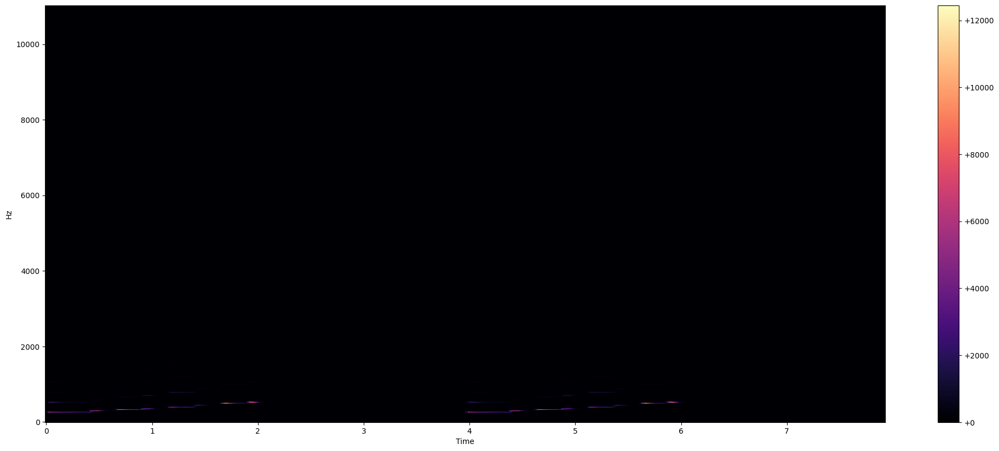

In [28]:
plot_spectrum(Y_scale, sr, HOP_SIZE)

**Log-Amplitude Spectrogram**

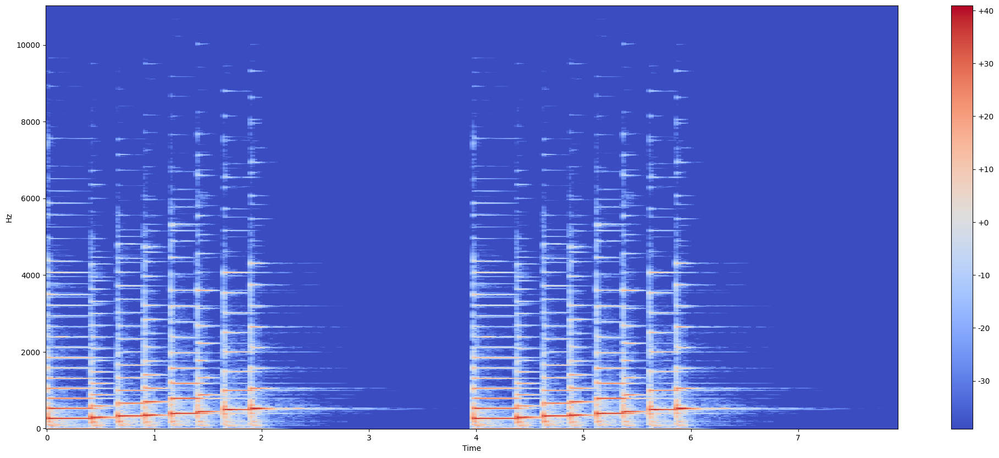

In [29]:
Y_log_scale = librosa.power_to_db(Y_scale)
plot_spectrum(Y_log_scale, sr, HOP_SIZE)

**Log-Frequency Spectrogram**

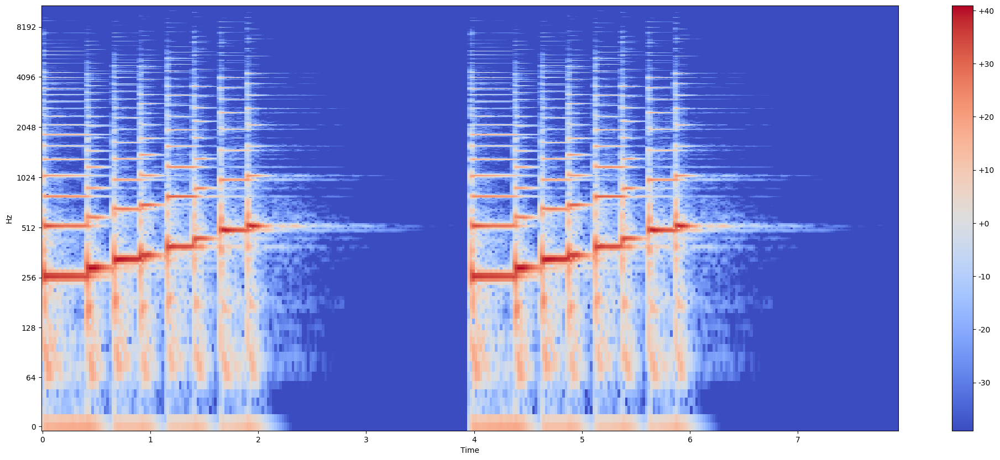

In [30]:
plot_spectrum(Y_log_scale, sr, HOP_SIZE, y_axis="log")

**Visualising songs from different genres**

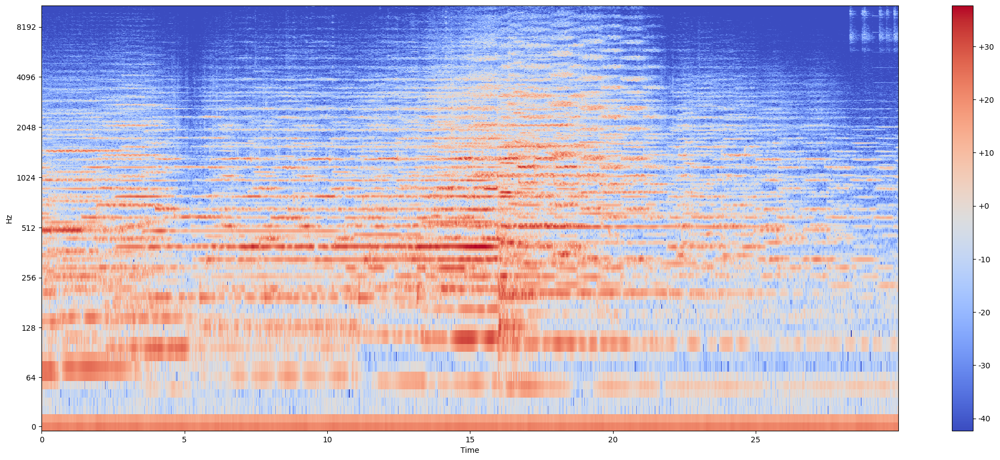

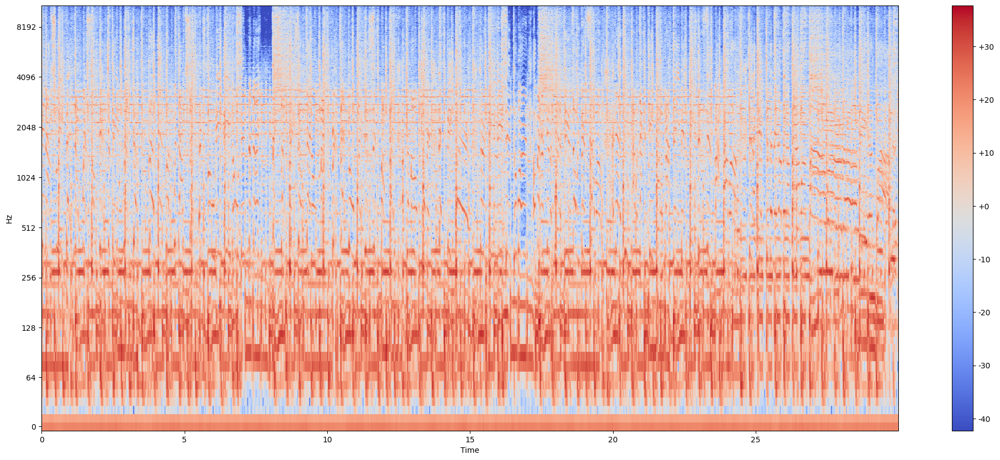

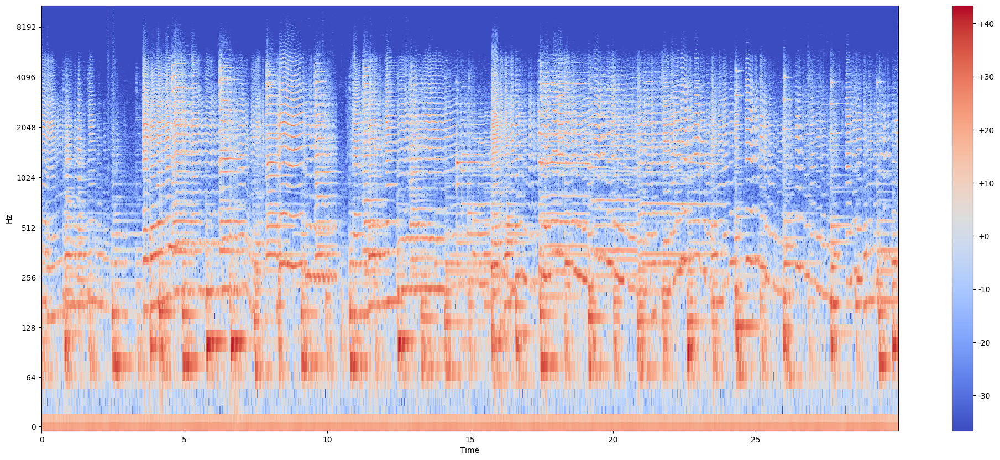

In [31]:
S_debussy = librosa.stft(debussy, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_redhot = librosa.stft(redhot, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
S_duke = librosa.stft(duke, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)


Y_debussy = librosa.power_to_db(np.abs(S_debussy) ** 2)
Y_redhot = librosa.power_to_db(np.abs(S_redhot) ** 2)
Y_duke = librosa.power_to_db(np.abs(S_duke) ** 2)

plot_spectrum(Y_debussy, sr, HOP_SIZE, y_axis="log")
plot_spectrum(Y_redhot, sr, HOP_SIZE, y_axis="log")
plot_spectrum(Y_duke, sr, HOP_SIZE, y_axis="log")

# **Mel Spectrograms Explained Easily**




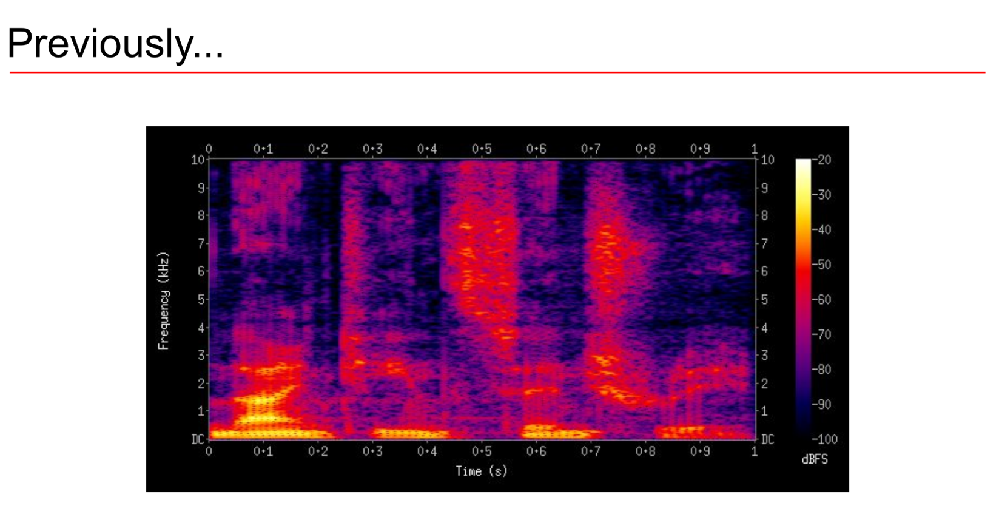

Mel Spectrograms are a **time-frequency representation of audio** that aligns with how humans perceive sound. They use the **Mel scale**, which is a logarithmic frequency scale inspired by human auditory perception. Mel spectrograms transform audio signals into features that emphasize perceptually relevant information, making them widely used in audio analysis and machine learning.

![](http://musicweb.ucsd.edu/~trsmyth/pitch2/img1.png)

---

## Why Use Mel Spectrograms?

### The Problem: Perceptual Non-Linearity of Human Hearing  
Humans perceive sound frequencies logarithmically. This means that equal perceptual differences in pitch are not spaced uniformly on a linear frequency scale. Traditional linear frequency analysis methods fail to align with how humans interpret audio signals.

#### Example:
- Frequencies **65–262 Hz** (C2 to C4) feel similar perceptually to **1568–1760 Hz** (G6 to A6), even though their linear frequency difference is much larger.

Using linear frequency analysis doesn't account for this perceptual effect, leading to inaccurate representations of sound.

---

## Ideal Audio Feature

An ideal audio feature must meet these goals:

1. Capture **time-frequency representation**, maintaining information about time and frequency.
2. Represent **perceptually relevant amplitude information**, aligning with how humans perceive loudness.
3. Provide **perceptually relevant frequency resolution**, emphasizing areas of human auditory interest.

Mel spectrograms achieve these goals by converting a signal's linear frequency into perceptually meaningful Mel frequencies.

---

## Understanding the Mel-Scale

The **Mel Scale** is a logarithmic frequency scale that models how humans perceive sound frequencies:

- Equal distances on the Mel scale correspond to equal perceived changes in pitch.
- Frequencies are spaced logarithmically rather than linearly.

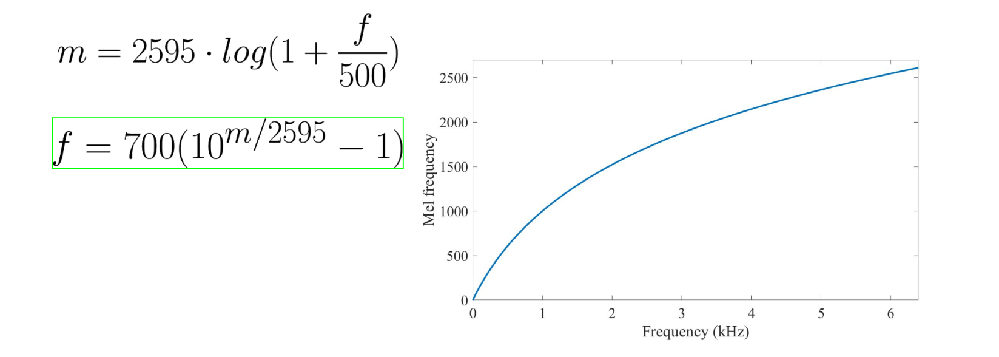

### Example:
- At **1000 Hz**, the corresponding Mel value is **1000 Mel**.
- Mel frequencies better represent perceptually relevant frequency analysis for humans.

Mel spectrograms transform audio signals into representations that emphasize human hearing characteristics.

---

## Recipe to Extract Mel Spectrogram

To compute Mel Spectrograms, follow these steps:

### 1. Extract the Short-Time Fourier Transform (STFT)
The STFT splits an audio signal into overlapping segments and computes their spectral representations over time, resulting in a **time-frequency spectrogram**.

### 2. Convert Amplitude to Decibels (dB)
Amplitude values are converted to logarithmic dB values to represent loudness in a way that aligns with human hearing.

### 3. Map Linear Frequencies to Mel Frequencies
Apply Mel filter banks to map linear frequencies from the STFT to Mel frequencies.

---
## How to Convert Frequencies to Mel Scale

Converting frequencies to the Mel scale is a critical step in audio signal processing, especially in applications like speech recognition, audio compression, and music analysis. The Mel scale is a perceptual scale of pitches that aligns more closely with human auditory perception compared to the linear frequency scale. The conversion process involves mapping standard frequency components into Mel bands, which correspond to how humans perceive sound frequencies.


### **Steps to Map Frequencies to the Mel Scale**

#### **1. Decide on the Number of Mel Bands**
The number of Mel bands defines how many perceptual frequency bins you will use in the Mel-scale transformation. These bins represent different ranges of frequencies on the Mel scale.

- **What are Mel bands?**  
  Mel bands divide the audio spectrum into segments that correspond to how humans hear sound, emphasizing perceptually important frequency regions.

- **Common Values for Mel Bands**:
  - **40 Mel Bands**: Suitable for most speech processing tasks.
  - **60 Mel Bands**: Common in applications that require fine-grained frequency analysis.
  - **90 Mel Bands**: Used in high-quality audio processing for complex audio signals.
  - **128 Mel Bands**: Frequently used for advanced audio recognition and machine learning tasks.

- **Why Choose a Specific Number?**  
  The choice depends on:
  - The **application domain**: Speech analysis, music, environmental sound analysis, etc.
  - **Computational complexity**: More Mel bands increase computation but provide better frequency resolution.


#### **2. Construct Mel Filter Banks**
Mel filters are applied to the linear frequency spectrum to group and emphasize important frequencies based on human hearing.

- **Mel Filter Characteristics**:
  - Triangular in shape.
  - Logarithmically spaced over the frequency range.
  - Designed to mimic how the ear responds to changes in sound frequency.

- **How they are spaced**:
  - At lower frequencies, the Mel scale spacing is wider because human hearing is less sensitive to changes in pitch at low frequencies.
  - At higher frequencies, Mel bands become more closely spaced to capture nuances in sound that humans can perceive.

- **Filter Bank Range**:  
  Mel filters typically span the range of audible human hearing (20 Hz to 20,000 Hz).

#### **Mel Frequency Equation**:
The conversion from frequency (f) in Hz to Mel scale uses the formula:
```
Mel(f) = 2595 * log10(1 + f / 700)

```
Where:
- `f` = frequency in Hz.
- The logarithmic transformation emphasizes perceptual hearing properties.

Using this equation, the entire range of 20-20,000 Hz is mapped onto Mel values using logarithmic spacing.

#### **3. Apply Mel Filters to the STFT**
After constructing the Mel filter banks, the next step involves applying them to the **Short-Time Fourier Transform (STFT)** of the audio signal.

- **STFT**:  
  This represents the signal's frequency content over time.

- **How Mel filters are applied to STFT**:
  1. Take the **spectrogram** (computed using STFT) that shows the magnitude of frequency components over time.
  2. Apply each Mel filter bank to the spectrogram. This effectively groups the frequency bins into Mel bands.
  3. Sum up spectral power across each Mel band over time to compute the Mel spectrogram.

#### **Mel Spectrogram**:
The Mel spectrogram represents the signal's power spectrum in terms of Mel frequencies over time. It emphasizes perceptually important frequencies by compressing the linear frequency scale into Mel bands.

- **Why is this done?**
  This allows machine learning models or audio processing algorithms to work with audio data in a way that aligns more closely with how humans hear sound.


### **Visualization Example**
1. **Linear Spectrum**: The raw STFT shows frequencies spaced linearly over time.
2. **Apply Mel Filter Banks**: Triangular Mel filters emphasize certain ranges of frequencies.
3. **Compute Mel Spectrogram**: Spectral power is aggregated across Mel bands over time to visualize time-frequency information in a way that models auditory perception.


### **Practical Use Cases**
The Mel scale conversion is widely used in:
- **Speech Recognition**: Mel spectrograms are input features for models like MFCCs (Mel-frequency cepstral coefficients).
- **Music Analysis**: Mel spectrograms analyze musical timbre, pitch, and harmony.
- **Sound Classification**: In environmental sound analysis or machine learning, Mel spectrograms are critical for features extraction.
- **Audio Compression**: Formats like MP3 use perceptual audio models based on Mel scaling.

---


## Mel Filter Banks

### What are Mel Filter Banks?
Mel filter banks are sets of triangular filters applied to the STFT to compute Mel spectrograms. They focus on specific frequency ranges that align with human auditory perception.

### How Are They Created?
1. Convert the lowest and highest frequencies in the range to their Mel equivalents.
2. Divide the frequency range into **N bands** spaced logarithmically on the Mel scale.
3. Map these Mel frequencies back into the linear frequency bins.
4. Apply triangular filters at each Mel frequency range.

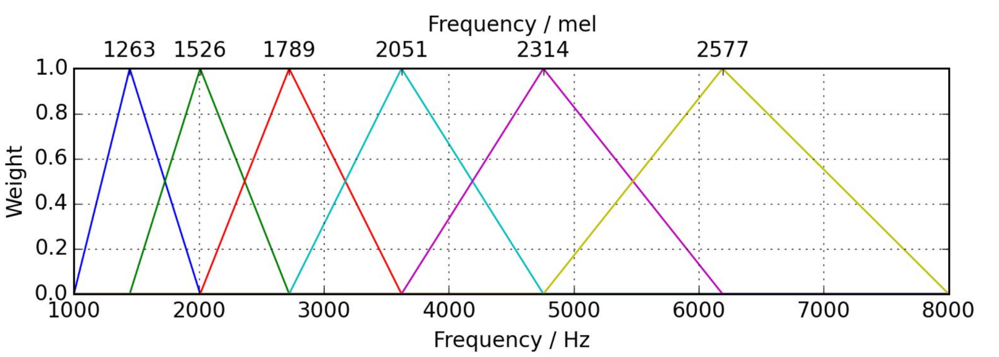

These filters emphasize specific ranges of frequencies that correspond to how humans hear sound.

---

## Applying Mel Filter Banks

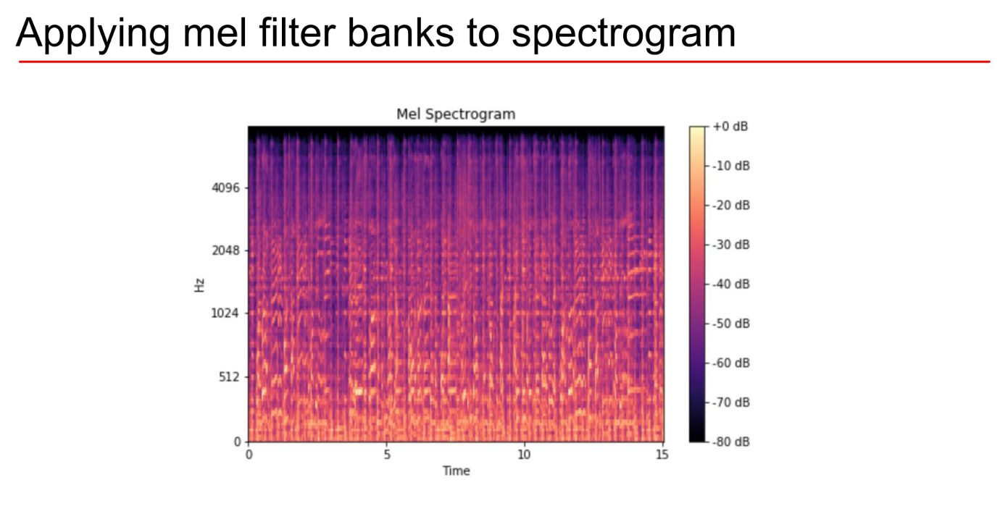

### Inputs:
1. **Spectrogram (from STFT)**: Dimensions are `(frequency bins, number of frames)`.
2. **Mel Filter Banks Matrix (M)**: Dimensions are `(number of Mel bands, number of linear frequency bins)`.

### Calculation:

The Mel spectrogram is calculated by multiplying the Mel filter bank matrix with the spectrogram:

```
Mel spectrogram = M × Spectrogram

```


The resulting Mel spectrogram has dimensions `(number of Mel bands, number of frames)`.


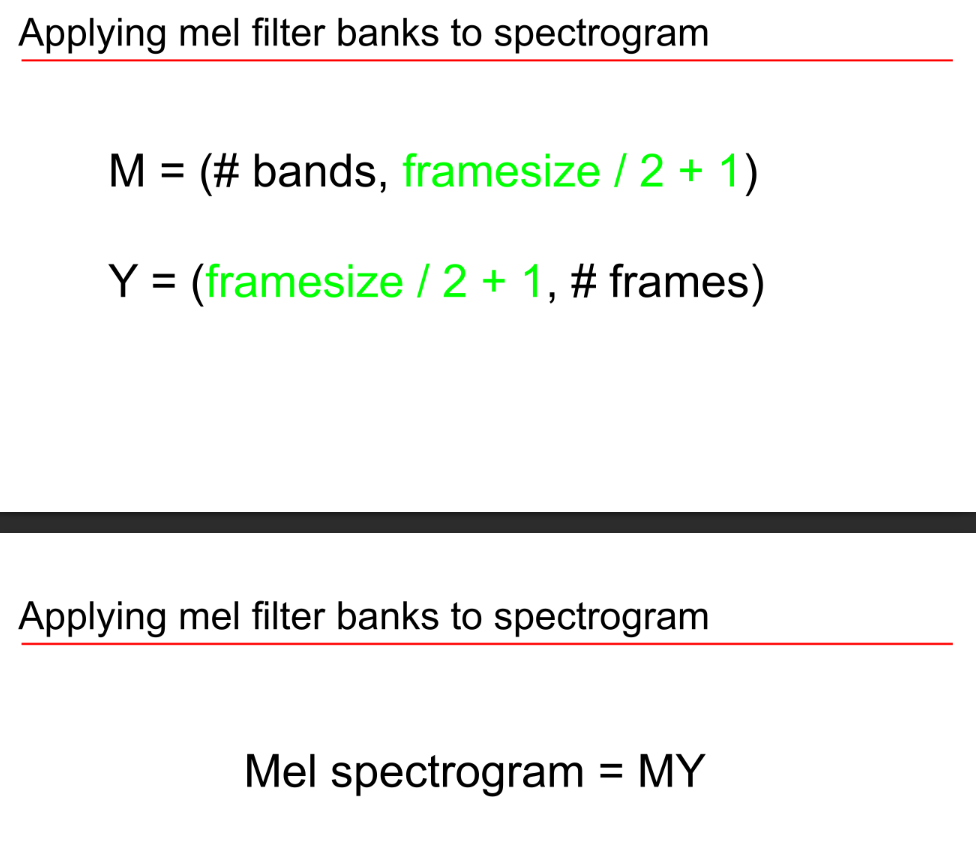

---

## Applications of Mel Spectrograms

Mel spectrograms are highly versatile and are used in a variety of fields:

1. **Audio Classification**: Identify categories of audio signals (speech, music, environmental sounds).
2. **Mood Recognition**: Detect emotional tone from audio signals by analyzing the changes in Mel spectrogram patterns.
3. **Music Genre Classification**: Predict the genre of a song based on its spectrogram data.
4. **Instrument Classification**: Identify the type of musical instrument from audio recordings.
5. **Speech Recognition**: Mel spectrograms act as features for speech-to-text algorithms.
6. **Sound Event Detection**: Detect specific audio events like sirens, applause, or footsteps.

---

## Why Mel Spectrograms Matter

Mel spectrograms are critical because they transform raw audio signals into representations that are both perceptually meaningful and suitable for machine learning. They mimic the way humans process sound, enabling machines to perform better on audio analysis tasks.

By focusing on human auditory perception, Mel spectrograms provide insights into time-varying patterns of sound that would be difficult to interpret using linear frequency analysis alone.

---

Mel spectrograms are therefore essential for audio recognition, machine learning models, and AI systems that process or analyze audio signals for classification, speech recognition, music analysis, and emotion detection.


# **Extracting Mel Spectrograms with Python**


In [33]:
import librosa
import librosa.display
import IPython.display as ipd
import matplotlib.pyplot as plt


In [34]:
Audio(scale_file)

In [35]:
scale, sr = librosa.load(scale_file)

In [43]:
scale

array([-4.2136759e-05, -4.8492290e-04, -4.6131760e-04, ...,
       -1.6643868e-06, -8.3810380e-07, -6.1924766e-08], dtype=float32)

**Mel filter banks**

In [40]:
filter_banks = librosa.filters.mel(n_fft=2048, sr=22050, n_mels=10)

In [41]:
filter_banks.shape

(10, 1025)

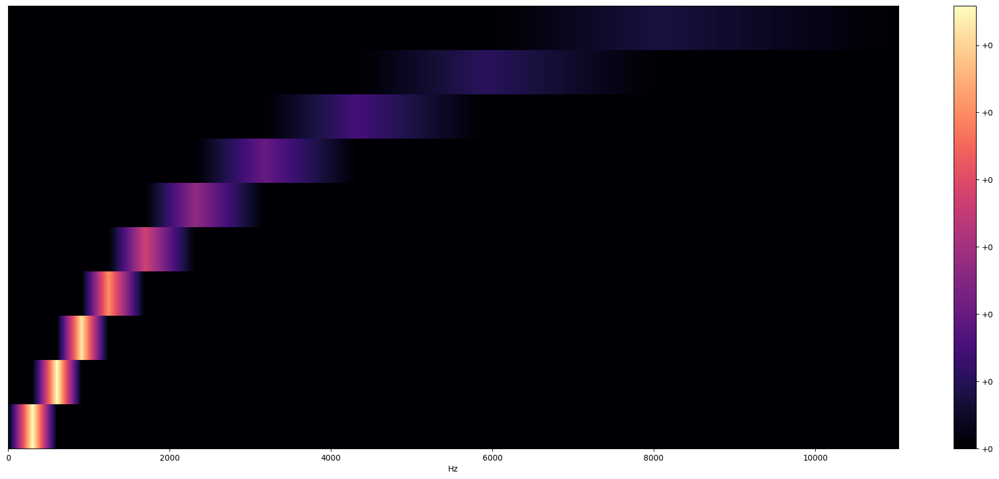

In [42]:
plt.figure(figsize=(25, 10))
librosa.display.specshow(filter_banks, 
                         sr=sr, 
                         x_axis="linear")
plt.colorbar(format="%+2.f")
plt.show()

**Extracting Mel Spectrogram**

In [46]:
mel_spectrogram = librosa.feature.melspectrogram(y=scale, sr=sr, n_fft=2048, hop_length=512, n_mels=10)


In [47]:
mel_spectrogram.shape

(10, 342)

In [48]:
log_mel_spectrogram = librosa.power_to_db(mel_spectrogram)

In [49]:
log_mel_spectrogram.shape

(10, 342)

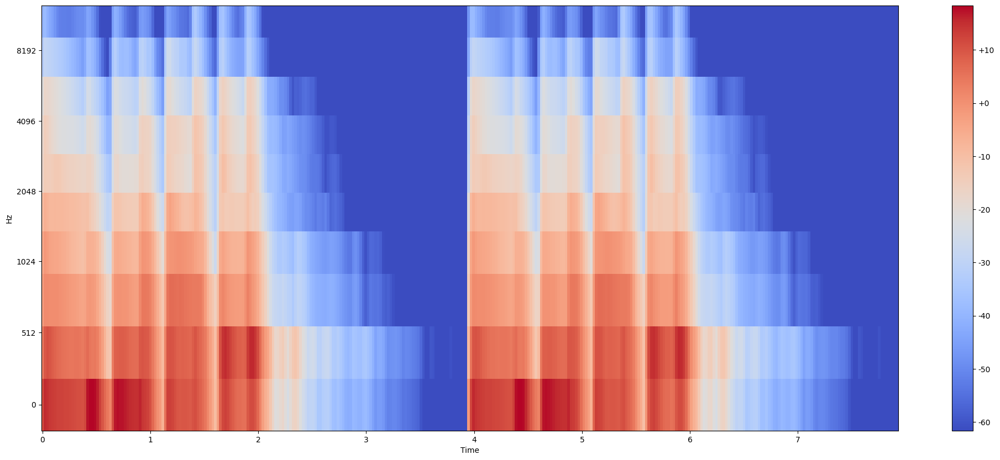

In [50]:
plt.figure(figsize=(25, 10))
librosa.display.specshow(log_mel_spectrogram, 
                         x_axis="time",
                         y_axis="mel", 
                         sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# **Mel-Frequency Cepstral Coefficients Explained Easily**




## What are Mel-Frequency Cepstral Coefficients (MFCCs)?

Mel-Frequency Cepstral Coefficients (MFCCs) are a compact numerical representation of audio signals. They are specifically designed to capture perceptually relevant features from sound signals, focusing on how humans perceive sound. MFCCs are essential features in machine learning models for **speech recognition**, **music analysis**, and **audio processing**.

MFCCs simplify raw audio signals into numerical data that can be used effectively by machine learning algorithms.

---

## Historical Background

The concept of MFCCs has a rich history that spans decades:

- **1960s**: The concept of *cepstrum* was first developed while studying echoes in seismic signals.
- **1970s**: Cepstrum became widely adopted as an audio feature for **speech recognition** and **speaker identification**.
- **2000s**: MFCCs expanded into **music analysis** and other audio-related research.

MFCCs are based on the mathematical representation known as **cepstrum**, which breaks down audio signals into their frequency components.

---

## How are MFCCs Computed?

MFCC computation involves a series of signal processing steps that transform audio signals into features that capture perceptual audio characteristics:

### Steps to Compute MFCCs

1. **Extract the waveform from the audio signal**:  
   Begin by loading the raw audio waveform from the recording or audio input.

2. **Apply the Discrete Fourier Transform (DFT)**:  
   - Transform the audio signal from the time domain into the frequency domain.
   - This represents the audio signal's frequency content.

3. **Take the logarithm of the amplitude spectrum**:  
   - The log transformation models how humans perceive loudness, as our perception scales logarithmically.

4. **Apply Mel Scaling**:  
   - Map the linear frequency spectrum into Mel scale frequencies.
   - Mel scaling aligns frequency analysis with human auditory perception.

5. **Apply Discrete Cosine Transform (DCT)**:  
   - Transform the log-Mel spectrum into MFCCs using DCT. This process reduces the number of features while retaining essential audio information.

---

## Why Use the Discrete Cosine Transform (DCT)?

DCT is an integral part of MFCC computation. Here's why:

1. **Simplified Fourier Analysis**:  
   DCT serves as a faster and efficient version of a full Fourier Transform for spectral analysis.

2. **Obtains Real-Valued Coefficients**:  
   DCT ensures numerical stability by avoiding complex coefficients.

3. **Removes Spectral Correlations**:  
   It reduces overlapping energy across Mel bands by effectively "decorrelating" features.

4. **Reduces Dimensionality**:  
   Only the most important features are retained after the DCT, optimizing computations for machine learning.

---

## How Many Coefficients Should We Use?

The number of coefficients retained from the DCT has a significant impact on the features' relevance:

### Common Practices
- Typically, **12 to 13 coefficients** are sufficient for most audio applications.
- These coefficients capture the general spectral envelope of the audio.

### Extended Feature Sets
- **Delta (Δ)**: Captures the rate of change in the MFCCs over time.
- **Delta-Delta (ΔΔ)**: Captures the acceleration (second derivatives) of these changes.

Combining static MFCCs with their Delta and Delta-Delta derivatives can result in a total feature set of **39 features per frame** (12 static MFCCs + Δ + ΔΔ).

---

## Advantages of Using MFCCs

1. **Focus on Perceptually Relevant Information**:  
   They capture large-scale spectral structures rather than fine spectral details.

2. **Well-Suited for Speech & Audio Applications**:  
   MFCCs work well for speech recognition, speaker identification, music classification, and audio event detection.

---

## Disadvantages of Using MFCCs

1. **Not Robust to Noise**:  
   MFCCs perform poorly in very noisy environments, as they are not designed to handle background sounds.

2. **Require Feature Engineering**:  
   They are handcrafted features that require careful tuning for specific use cases.

3. **Inefficient for Audio Synthesis**:  
   MFCCs are typically used for analysis, not for generating audio signals.

---

## Applications of MFCCs

MFCCs are applied in a wide variety of domains, including:

### 1. Speech Processing:
   - **Speech recognition**: Converting spoken audio into text.
   - **Speaker identification**: Distinguishing speakers based on their voice patterns.

### 2. Music Processing:
   - **Genre classification**: Determining a song's genre based on its audio features.
   - **Mood detection**: Predicting the emotional tone of a song or instrumental recording.
   - **Music tagging**: Automatically categorizing music tracks with labels.

---

## Visualizing MFCCs

MFCCs can be visualized as a 2D matrix, showing how the spectral features evolve over time:

### Visualization Axes:
- **Y-axis**: MFCC coefficients (representing frequency information).
- **X-axis**: Audio frames over time.

Such visualizations provide insights into spectral changes over time, showing patterns in speech or musical notes.

---

## Summary

MFCCs are compact numerical representations that translate raw audio signals into features suitable for machine learning tasks. They capture human auditory perception properties, emphasizing the most important spectral patterns for audio analysis.

Despite their simplicity and efficiency, they remain one of the most widely used features in speech recognition, speaker analysis, and audio classification tasks.


# **Short-Time Fourier Transform Explained Easily**
